In [2]:
fig_save_path = '/data/peer/wallet/Jupyter/2023_Particle_SASP/figures/'

In [3]:
DATA_DIR = '/data/peer/wallet/Jupyter/2023_Particle_SASP/data/'

In [4]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata
import scipy.sparse as sparse
import matplotlib.pyplot as plt
import seaborn as sns
from kneed import KneeLocator
from scanpy.external.pp import magic
import scanpy.external as sce




In [5]:
from scrnaseq_preprocessing_utils import *

In [6]:
color_map_clusters_nogrey = ["#FFFF00", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]
blue_red = ['#DE2A1B','#1B2ADE',"#1CE6FF", ]
#scanpy layout
sc.set_figure_params(scanpy=True, dpi=150, dpi_save=150, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')
sns.set_style('white')
sc.settings.verbosity = 3

In [7]:

batlow_20 = ['#1d2356','#1d2b59',
'#14375e',
'#134460',
'#1c5261',
'#235f5f',
'#396a58',
'#4c714e',
'#607843',
'#757e36',
'#8d8532',
'#a78b30',
'#c49138',
'#dc954d',
'#f09c6a',
'#f8a487',
'#f8aca2',
'#f8b5be',
'#f8c2d9',
'#eecbe1'] 
import random
random.seed(1)
random.shuffle(batlow_20)


# reannotate immune

In [7]:
adata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK.h5ad'
adata_save_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_{}hv.h5ad'
immune_markers_path = '/data/peer/wallet/Jupyter/2023_Particle_SASP/2023_Particle_SASP/'+'immune_marker_panel_clean_210216.csv'
marker_gene_path = '/data/peer/wallet/Jupyter/2023_Particle_SASP/2023_Particle_SASP/230529_marker_genes_hv.csv'
marker_gene_sets =[ 'TNK_important_marker', 'ILC_important_marker',]#'B_important_marker','M_important_marker', 'DC_important_marker',
use_hv_genes = True
add_marker_genes=True
number_of_hv_genes = 1500


pheno_names = ['pheno_var_TNK_k10','pheno_var_TNK_k20','pheno_var_TNK_k30','pheno_var_TNK_k40','pheno_var_TNK_k50','pheno_var_TNK_k60','pheno_var_TNK_k70',
              'pheno_var_TNK_k80','pheno_var_TNK_k90','pheno_var_TNK_k100']

#pheno_names = ['pheno_k10','pheno_k20','pheno_k30','pheno_k40','pheno_k50','pheno_k60','pheno_k70',
 #             'pheno_k80','pheno_k90','pheno_k100']
pheno_ks = [10,20,30,40,50,60,70,80,90,100]

min_cells_per_gene = 10

min_gene_number = 50

In [148]:
adata = sc.read(adata_path)
adata

AnnData object with n_obs × n_vars = 7714 × 16286
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF'

In [149]:
sc.pp.filter_genes(adata, min_cells=min_cells_per_gene)

filtered out 2961 genes that are detected in less than 10 cells


In [150]:
adata

AnnData object with n_obs × n_vars = 7714 × 13325
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF'

In [151]:
sc.pp.filter_cells(adata, min_genes= min_gene_number)


In [152]:
adata

AnnData object with n_obs × n_vars = 7714 × 13325
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF'

In [153]:
if use_hv_genes:
    sc.pp.highly_variable_genes(adata,  flavor='cell_ranger', n_top_genes=number_of_hv_genes)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [154]:
number_of_hv_genes

1500

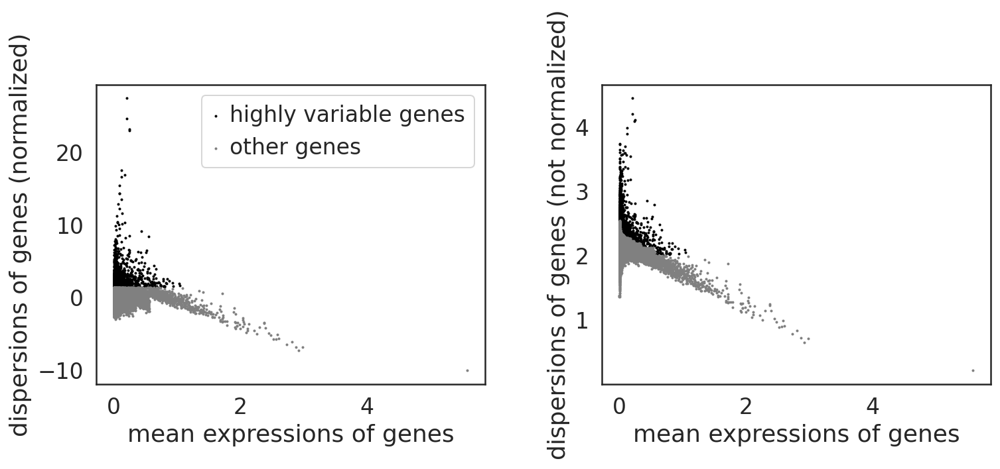

In [155]:
if use_hv_genes:
    sc.pl.highly_variable_genes(adata,  show=None, save=None, highly_variable_genes=True)

In [156]:
if add_marker_genes and use_hv_genes:
    marker_genes_df = pd.read_csv(immune_markers_path,index_col=['gene_name'])


In [157]:
#limit to human only
if add_marker_genes and use_hv_genes:
    marker_genes_df = marker_genes_df[marker_genes_df['species'] == 'homo_sapiens']
    marker_genes_df

In [158]:
#limit to markers used for distinguishing immune cells
if add_marker_genes and use_hv_genes:
    marker_genes_df = marker_genes_df[marker_gene_sets]
    marker_genes_df

In [159]:
#extract gene names
if add_marker_genes and use_hv_genes:
    marker_lists = []
    for i in marker_gene_sets:
        marker_genes_list = list(set(marker_genes_df[marker_genes_df[i]==True].index))
        marker_lists.append(marker_genes_list)
    marker_lists

In [160]:
#concatenate lists
if add_marker_genes and use_hv_genes:
    import itertools
    a = marker_lists
    marker_genes = list(itertools.chain.from_iterable(a))
    marker_genes

In [161]:
#set important marker genes as highly variable
if add_marker_genes and use_hv_genes:
    for i in marker_genes:
        if i in adata.var_names:
            adata.var['highly_variable'][i]= True
        else:
            print(i, 'not found')

KIR2DL5A not found
IL13 not found
IL17F not found
EGR2 not found
HLA-DRB3 not found
KIR3DL3 not found
NCR2 not found
KIR2DL2 not found
IL17A not found
KIR2DL1 not found
HNF1A not found
KIR2DL5B not found
IL9 not found
IL4 not found
KIR3DL2 not found
PTGDR2 not found
IL6 not found
CXCR1 not found
TYRO3 not found
FGFBP2 not found
TGFB2 not found
TNFRSF9  not found
HLA-DRB4 not found
PF4 not found
IL22 not found
KLRK1 not found
ALK4 not found
VSIR not found
PDGFRA not found
PPBP not found
HLA-DRB3 not found
HLA-DRB4 not found


/scratch/lsftmp/18708082.tmpdir/ipykernel_409261/4083173082.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var['highly_variable'][i]= True


In [162]:
adata[:,'FASLG'].var['highly_variable']

FASLG    True
Name: highly_variable, dtype: bool

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:00)


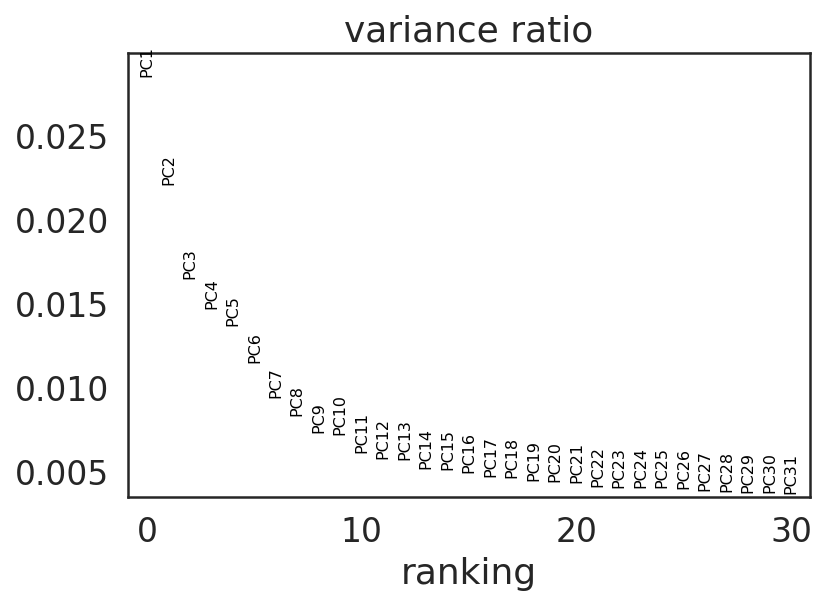

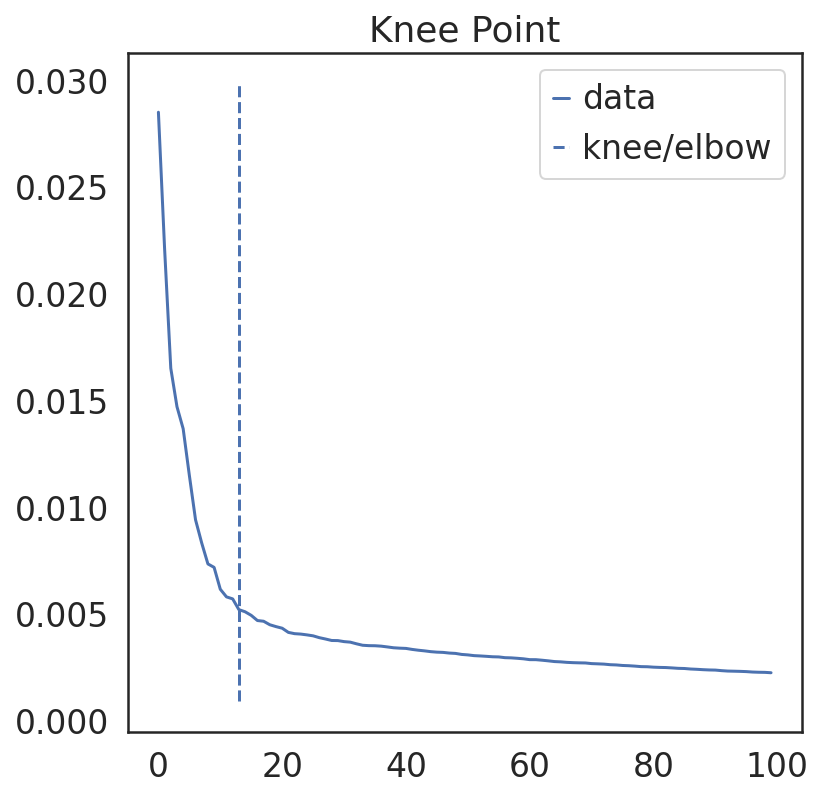

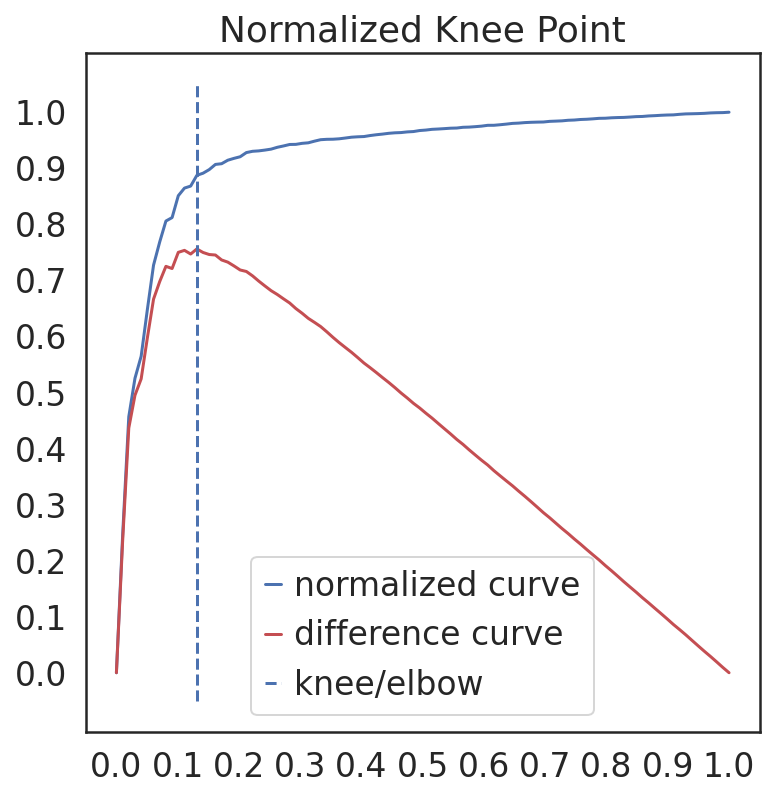

Kneepoint happens at PC: 13
13 PC explain 15.716622117906809 % of variance
2 PC explain 5.064808018505573 % of variance
3 PC explain 6.717539578676224 % of variance
4 PC explain 8.190301153808832 % of variance
5 PC explain 9.55988448113203 % of variance
6 PC explain 10.711118578910828 % of variance
7 PC explain 11.654077656567097 % of variance
8 PC explain 12.488062400370836 % of variance
9 PC explain 13.224341906607151 % of variance
10 PC explain 13.944425387308002 % of variance
11 PC explain 14.56214771606028 % of variance
12 PC explain 15.144067071378231 % of variance
13 PC explain 15.716622117906809 % of variance
14 PC explain 16.238868422806263 % of variance
15 PC explain 16.75109942443669 % of variance
16 PC explain 17.246425058692694 % of variance
17 PC explain 17.71754091605544 % of variance
18 PC explain 18.18529786542058 % of variance
19 PC explain 18.63667843863368 % of variance
20 PC explain 19.079345744103193 % of variance
21 PC explain 19.51449397020042 % of variance
22 P

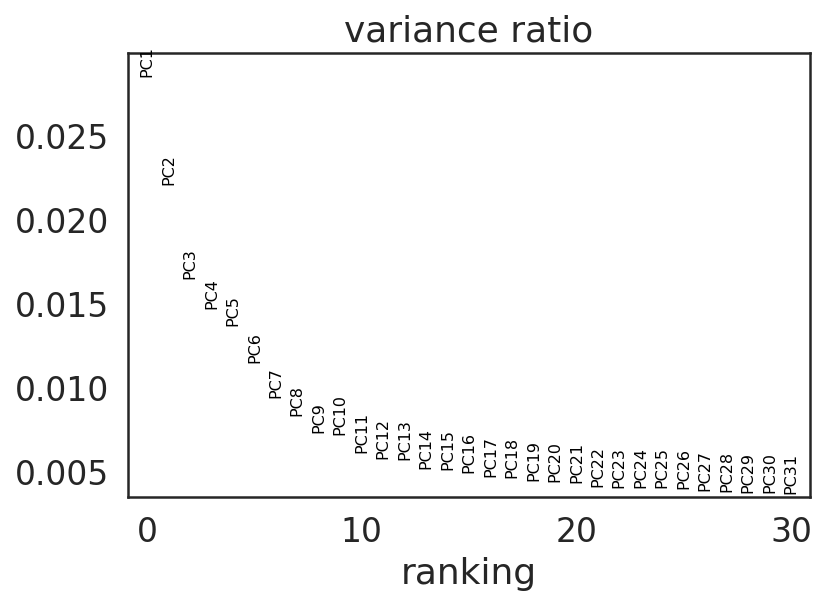

In [163]:
if use_hv_genes:
    number_of_PC_used = calculate_optimal_PC(adata, min_PC = 50, min_var=25, n_comps=100, use_hv=True)
else:
    number_of_PC_used = calculate_optimal_PC(adata, min_PC = 50, min_var=25, n_comps=100, use_hv=False)

In [164]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=number_of_PC_used)
sc.tl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)


In [165]:
for i,v in enumerate(pheno_names):
    result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = pheno_ks[i], seed=1)
    adata.obs[v] = pd.Categorical(result_pheno_ndf_all[0])

PhenoGraph clustering
Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 1.6860113143920898 seconds
Jaccard graph constructed in 3.9125852584838867 seconds
Wrote graph to binary file in 0.027744293212890625 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.838675
After 2 runs, maximum modularity is Q = 0.83993
Louvain completed 22 runs in 1.5053374767303467 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 10.50840163230896 seconds
    finished (0:00:10)
PhenoGraph clustering
Finding 20 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 1.623098373413086 seconds
Jaccard graph constructed in 3.8455796241760254 seconds
Wrote graph to binary file in 0.07211470603942871 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.807102
After 7 runs, maximum modularity is Q = 0.809008
Louvain completed 27 runs in 2.6120

In [166]:
#impute data
adata_indf = magic(adata, copy=True, verbose=True, solver='exact', n_pca=adata.obsm['X_pca'].shape[1], knn=5, t=3)
adata.layers['imputed'] = adata_indf.X

computing MAGIC
Calculating MAGIC...
  Running MAGIC on 7714 cells and 13325 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 2.56 seconds.
    Calculating KNN search...
    Calculated KNN search in 3.08 seconds.
    Calculating affinities...
    Calculated affinities in 3.07 seconds.
  Calculated graph and diffusion operator in 8.72 seconds.
  Running MAGIC with `solver='exact'` on 13325-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 7.89 seconds.
Calculated MAGIC in 16.76 seconds.
    finished (0:00:17)


In [167]:
adata_save_path.format(str(number_of_hv_genes))

'/data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_1500hv.h5ad'

In [168]:
adata.write(adata_save_path.format(str(number_of_hv_genes)))
print('saved data to:',adata_save_path.format(str(number_of_hv_genes)))

saved data to: /data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_1500hv.h5ad


# plot cells

In [342]:
#adata paths
pheno_names = ['pheno_var_TNK_k10','pheno_var_TNK_k20','pheno_var_TNK_k30','pheno_var_TNK_k40','pheno_var_TNK_k50','pheno_var_TNK_k60','pheno_var_TNK_k70',
              'pheno_var_TNK_k80','pheno_var_TNK_k90','pheno_var_TNK_k100']
pheno_heat = 'pheno_var_TNK_k20'  
adata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_2500hv.h5ad'
#set parameters
imputed = True
continue_with_adata = False #load new adata indicated by paths below or continue with loaded adata object
M_genes = ['CD68','MRC1','CD14','FUT4','CSF3R','CXCR1','HDC','ID2','BATF3','IRF8','TCF4','IRF4','CD207']
marker_genes = [ M_genes]
marker_genes_filtered = [[]]

In [343]:
import cytopus as cp
G = cp.kb.KnowledgeBase()

KnowledgeBase object containing 75 cell types and 201 cellular processes



In [344]:
#load AnnData object
if continue_with_adata == False:
    adata = sc.read(adata_path)

In [345]:
adata

AnnData object with n_obs × n_vars = 7714 × 13325
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF'

In [346]:
# Filter out genes not present in single cell data
for i,v in enumerate(marker_genes):
    for marker in v:
        if marker in adata.var.index:   
            marker_genes_filtered[i].append(marker)
            marker_genes_filtered[i] = list(set(marker_genes_filtered[i]))
        else:
            print(marker + ' filtered out')
            

FUT4 filtered out
CXCR1 filtered out
CD207 filtered out


In [347]:
#imputed variable serves to define option in sc.pl.umap function

if imputed == True:
    select_layer = 'imputed'
else:
    select_layer = None

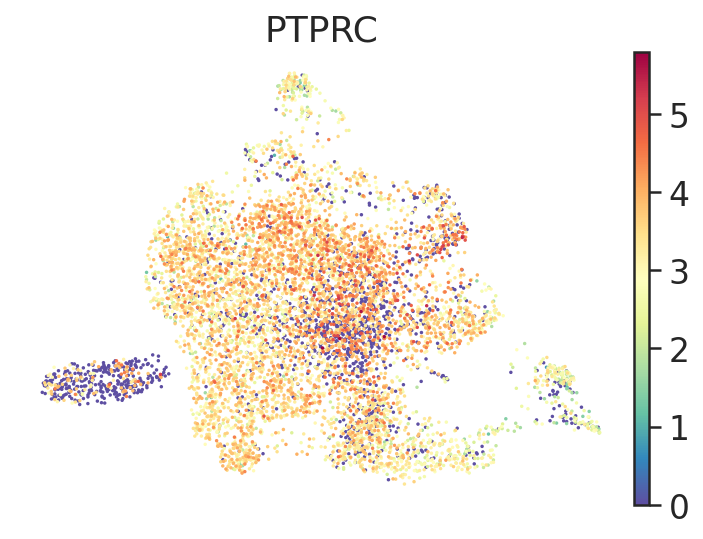

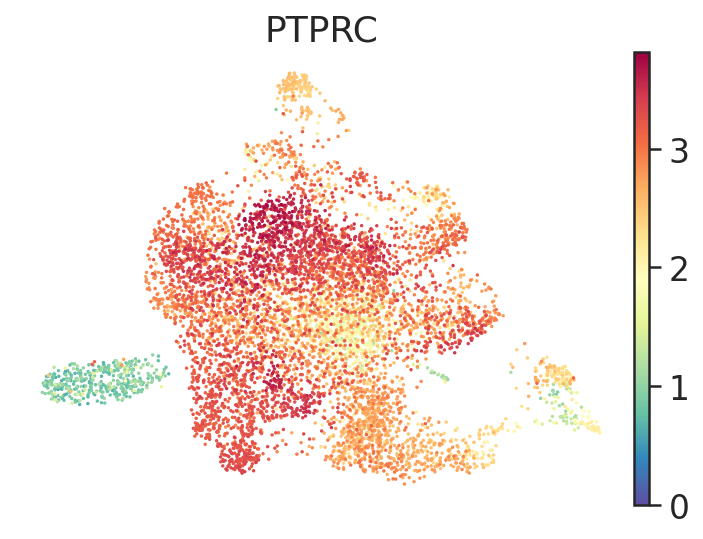

In [348]:
#stem cells, erythrocyte contamination
genes_oi = ['PTPRC','HBB','HBA1','HBA2','CD34']
genes_oi = [x for x in genes_oi if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = genes_oi, layer='imputed', s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

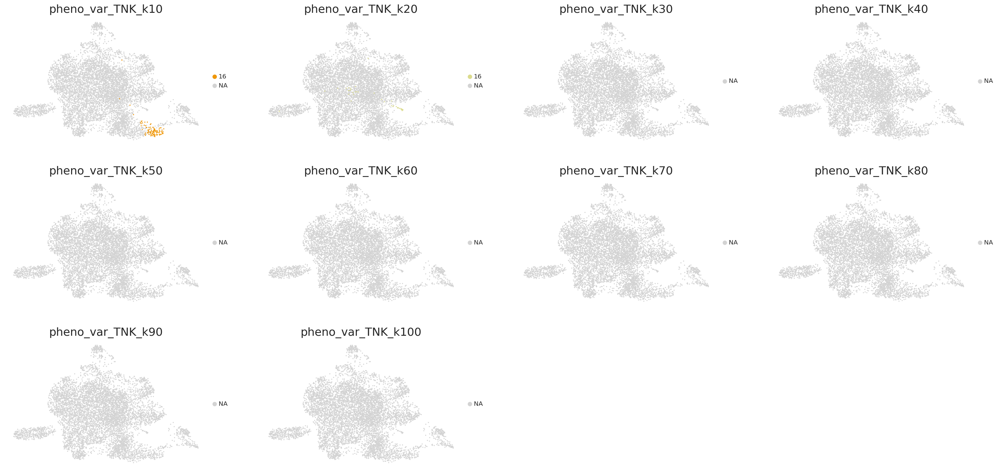

In [329]:
sc.pl.umap(adata, color = pheno_names, s = 12, groups=[16],cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)


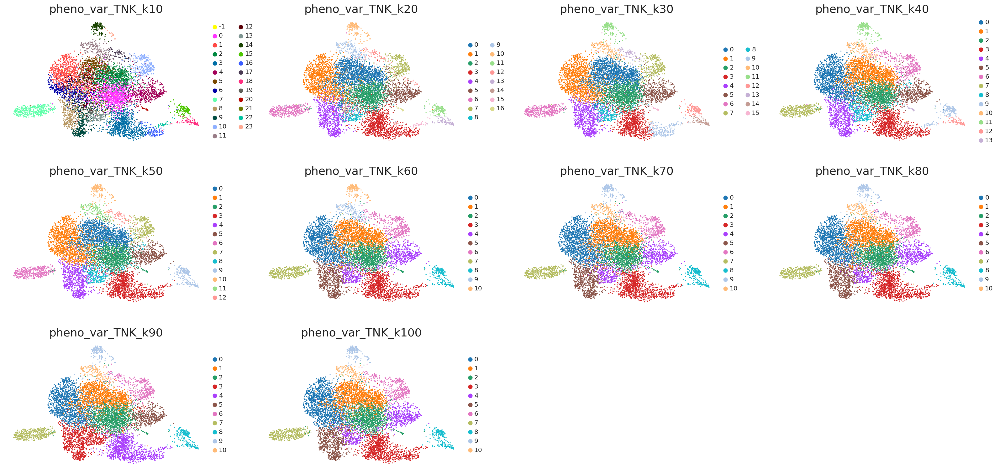

In [148]:
#stem cells, erythrocyte contamination
sc.pl.umap(adata, color = pheno_names, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)


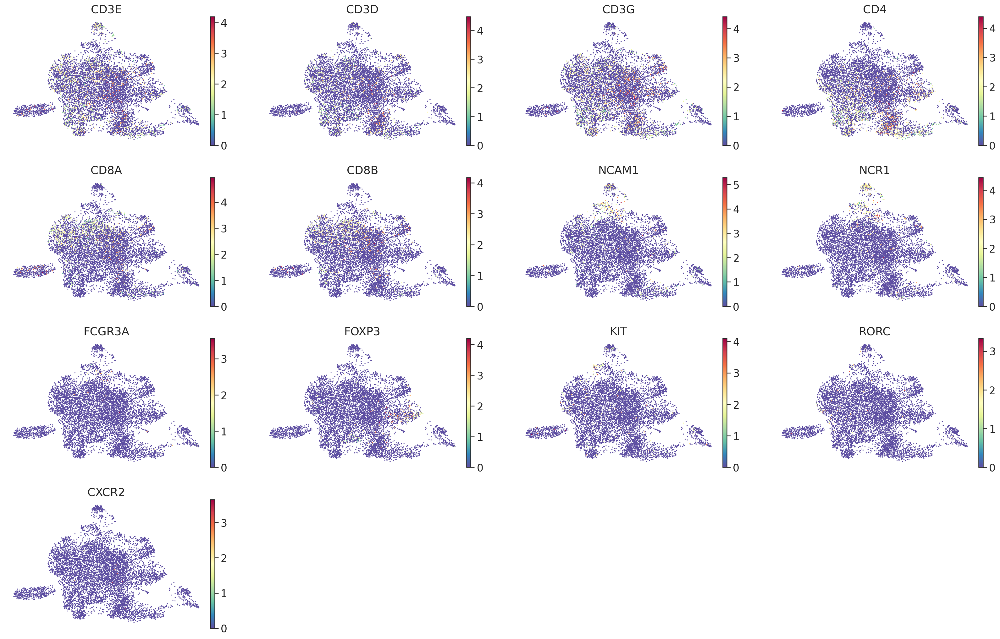

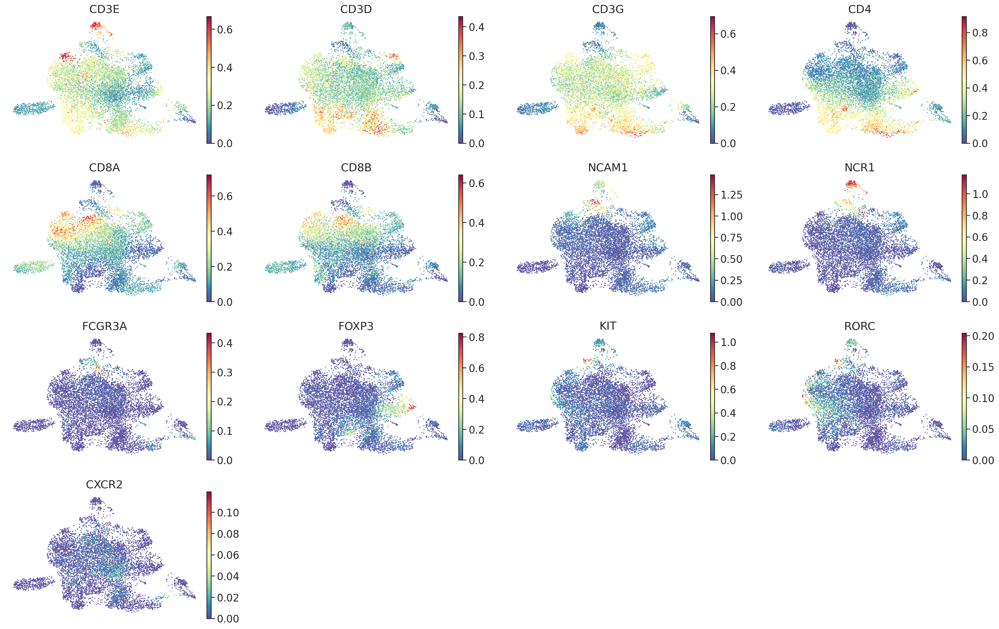

In [149]:
#markers
genes_oi = ['CD3E','CD3D','CD3G','CD4','CD8A','CD8B','NCAM1','NCR1','FCGR3A','FOXP3','KIT','RORC','CXCR1','CXCR2']
genes_oi = [x for x in genes_oi if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = genes_oi, layer='imputed', s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

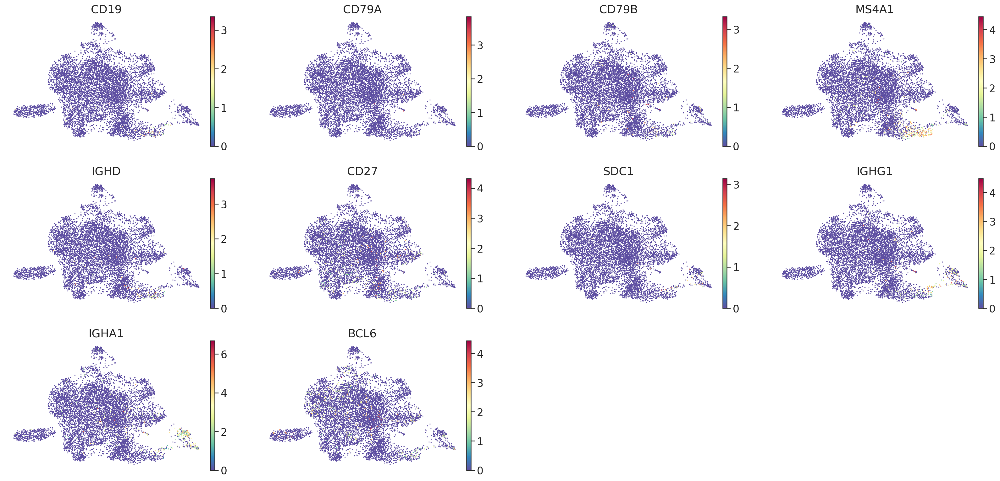

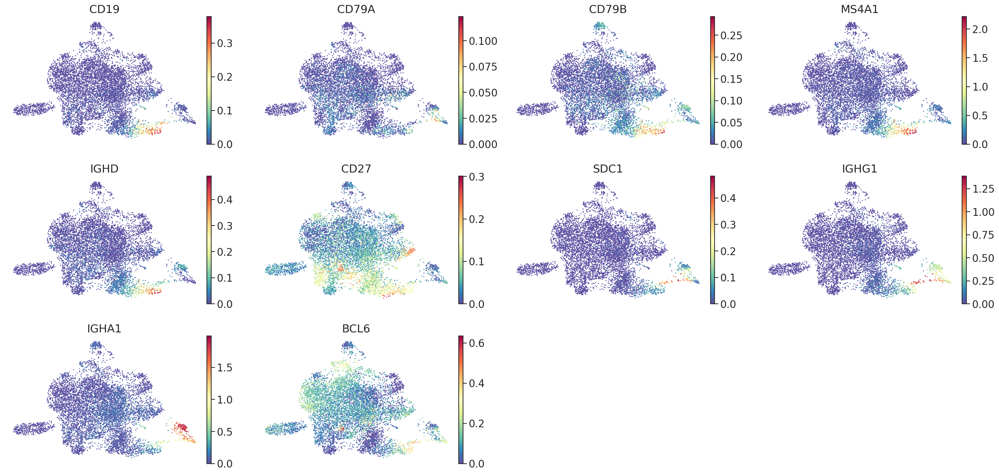

In [150]:
#markers
genes_oi = ['CD19','CD79A','CD79B','MS4A1','IGHD','CD27','SDC1','IGHG1','IGHA1','AICDA','BCL6']
genes_oi = [x for x in genes_oi if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = genes_oi, layer='imputed', s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

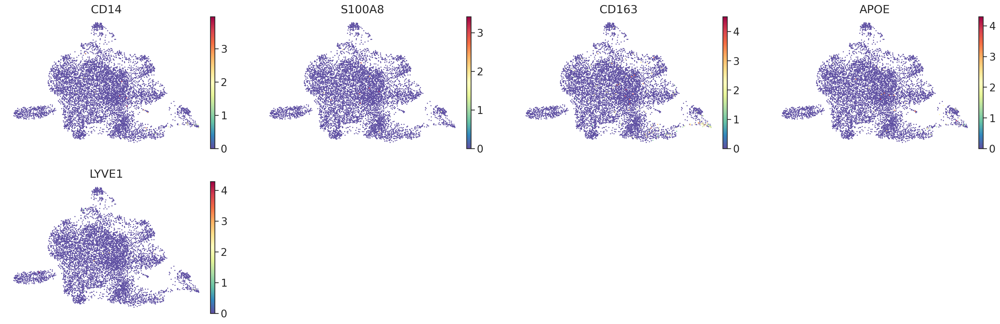

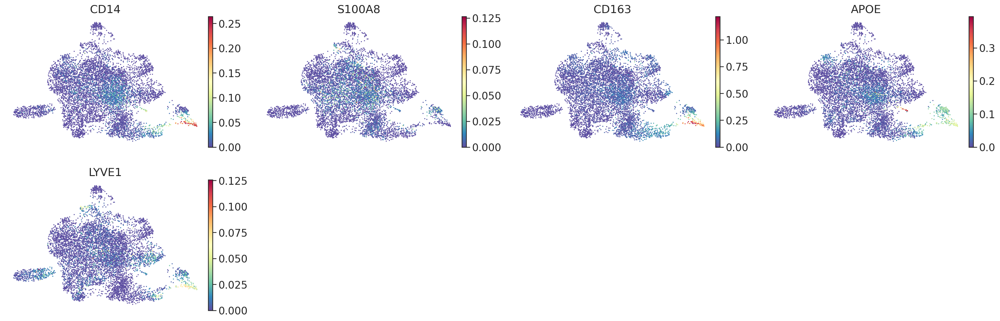

In [151]:
#markers
genes_oi = ['CD14','S100A8','S100A9','CEBPA','CD163','MARCO','APOE','LYVE1','RNASE1','FOLR2']
genes_oi = [x for x in genes_oi if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = genes_oi, layer='imputed', s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

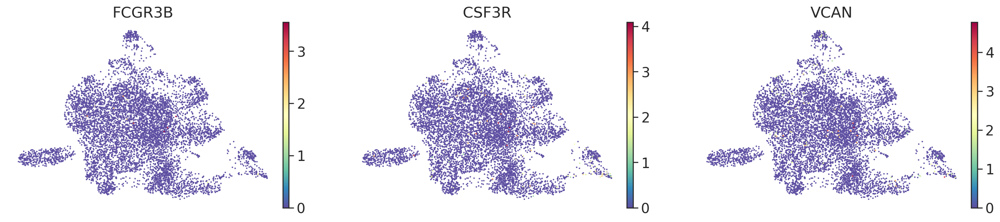

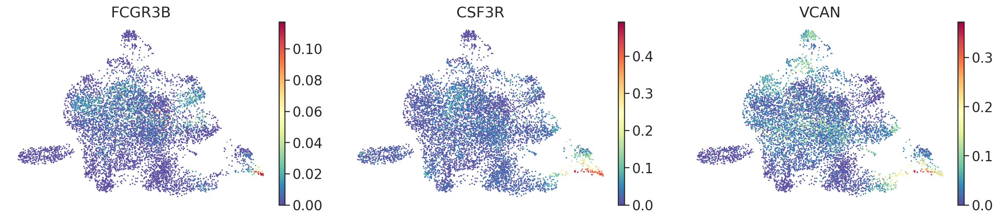

In [152]:
#markers
genes_oi = ['FCGR3B','CSF3R','VCAN','AZU1','CXCR1']
genes_oi = [x for x in genes_oi if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = genes_oi, layer='imputed', s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

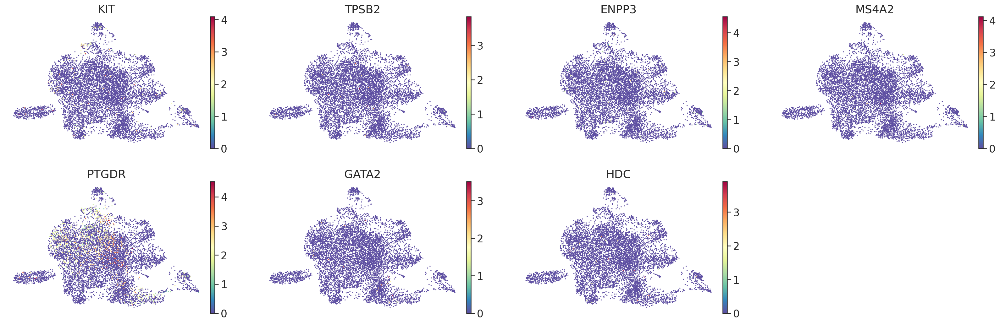

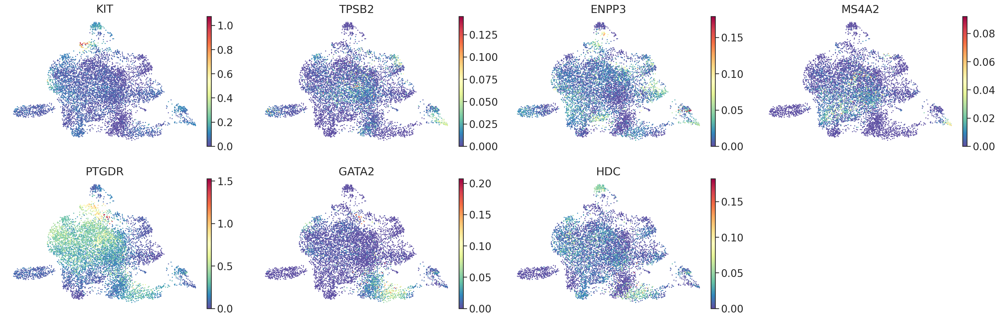

In [153]:
#markers
genes_oi = G.identities['mast']
genes_oi = [x for x in genes_oi if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = genes_oi, layer='imputed', s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

## calculate pairwise rand index

In [154]:
#set parameters
continue_with_adata = False #load new adata indicated by paths below or continue with loaded adata object

#adata paths

pheno_names = ['pheno_var_TNK_k10','pheno_var_TNK_k20','pheno_var_TNK_k30','pheno_var_TNK_k40','pheno_var_TNK_k50','pheno_var_TNK_k60','pheno_var_TNK_k70',
              'pheno_var_TNK_k80','pheno_var_TNK_k90','pheno_var_TNK_k100']
#pheno_names = ['pheno_k10','pheno_k20','pheno_k30','pheno_k40','pheno_k50','pheno_k60','pheno_k70',
#             'pheno_k80','pheno_k90','pheno_k100']

In [155]:
from sklearn.metrics import adjusted_rand_score

In [156]:
if continue_with_adata == False:
    adata_sample = sc.read(adata_path)
adata_sample   

AnnData object with n_obs × n_vars = 7714 × 13325
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF'

In [157]:
#bootstrap 10000 cells from adata to avoid int overflow,if adata < 100 000 cells use all cells

if len(adata.obs_names) > 100000:
    adata_sample = adata[adata.obs.sample(n=100000, replace=False, random_state=1, axis=0).index,:]

In [158]:
#if you get overflow error that means that the calculation intermediate results are too big to store into np.int64
#this messes up the entire calculatation so you have to downsample the cells
rand_indices = pd.DataFrame(index=pheno_names, columns=pheno_names)

for i in pheno_names:
    for j in pheno_names:
        a = np.int64(np.array(adata_sample.obs[i]))
        b = np.int64(np.array(adata_sample.obs[j]))
        c = adjusted_rand_score(a, b)
        rand_indices.loc[i,j] = c

In [159]:
rand_indices

,pheno_var_TNK_k10,pheno_var_TNK_k20,pheno_var_TNK_k30,pheno_var_TNK_k40,pheno_var_TNK_k50,pheno_var_TNK_k60,pheno_var_TNK_k70,pheno_var_TNK_k80,pheno_var_TNK_k90,pheno_var_TNK_k100
pheno_var_TNK_k10,1.0,0.546017,0.53394,0.535426,0.528474,0.514223,0.518764,0.510982,0.496989,0.505767
pheno_var_TNK_k20,0.546017,1.0,0.812489,0.794154,0.785884,0.768415,0.767444,0.769071,0.748585,0.748943
pheno_var_TNK_k30,0.53394,0.812489,1.0,0.842798,0.859881,0.829398,0.814615,0.822651,0.806731,0.804219
pheno_var_TNK_k40,0.535426,0.794154,0.842798,1.0,0.874321,0.864212,0.854004,0.838555,0.815373,0.814588
pheno_var_TNK_k50,0.528474,0.785884,0.859881,0.874321,1.0,0.914898,0.892186,0.882955,0.879236,0.882628
pheno_var_TNK_k60,0.514223,0.768415,0.829398,0.864212,0.914898,1.0,0.933377,0.935816,0.877072,0.914103
pheno_var_TNK_k70,0.518764,0.767444,0.814615,0.854004,0.892186,0.933377,1.0,0.927775,0.87024,0.916303
pheno_var_TNK_k80,0.510982,0.769071,0.822651,0.838555,0.882955,0.935816,0.927775,1.0,0.889874,0.912412
pheno_var_TNK_k90,0.496989,0.748585,0.806731,0.815373,0.879236,0.877072,0.87024,0.889874,1.0,0.900778
pheno_var_TNK_k100,0.505767,0.748943,0.804219,0.814588,0.882628,0.914103,0.916303,0.912412,0.900778,1.0


<AxesSubplot:>

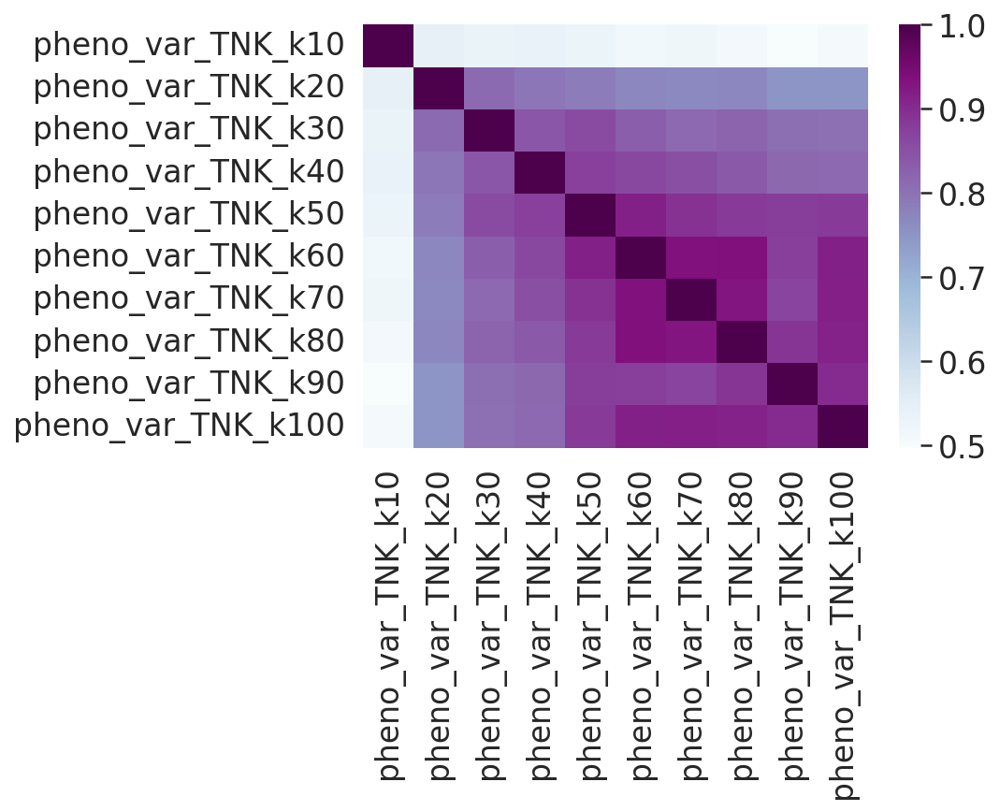

In [160]:
#plot rand indices
sns.heatmap(rand_indices.astype('float'),
                    cmap='BuPu',
                    cbar=True,
                    yticklabels=True,
                    xticklabels=True,
                  # vmax=1,
                   # center=0.5,
                    #vmin=0)
            )

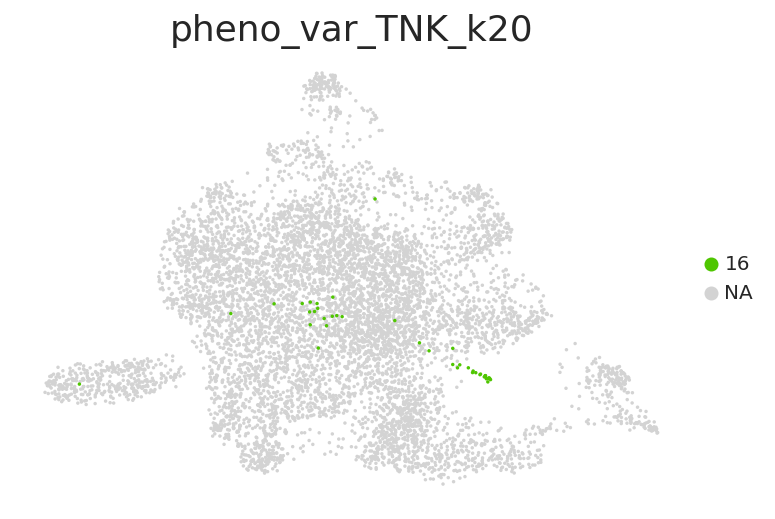

In [161]:
sc.pl.umap(adata, color = pheno_heat, palette=color_map_clusters_nogrey, s = 12, groups=[16],cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

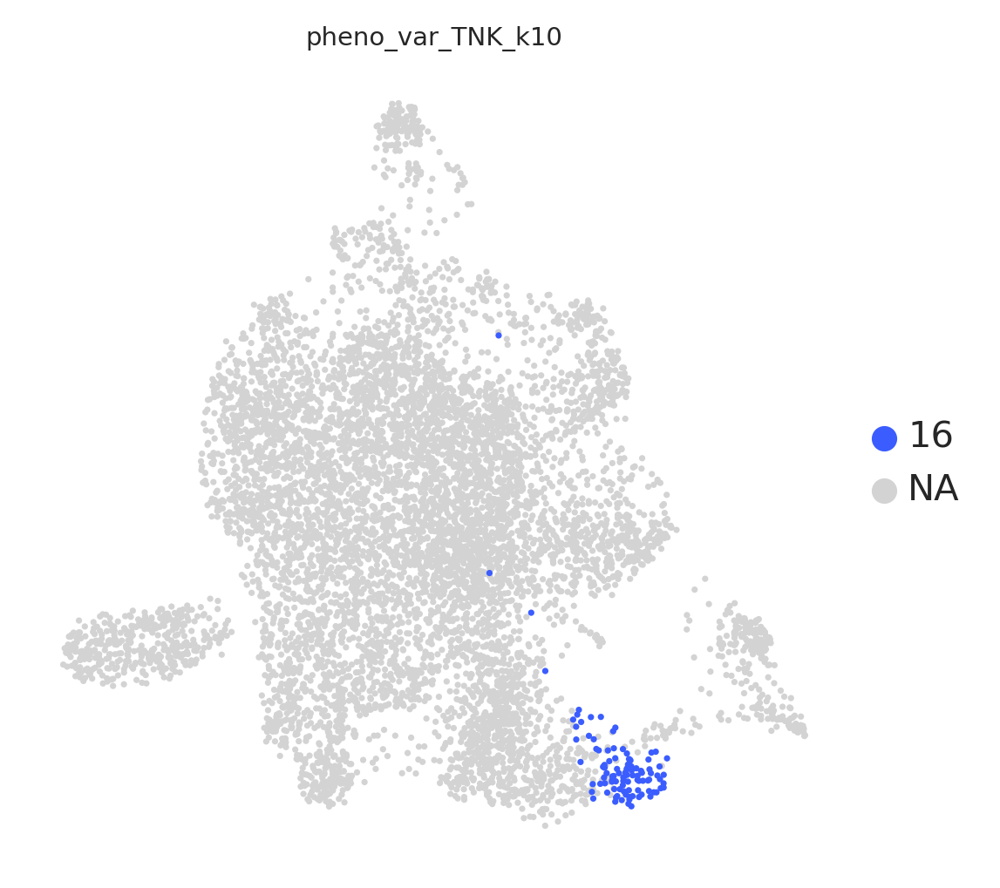

In [13]:
sc.pl.umap(adata, color = 'pheno_var_TNK_k10', groups=[16], palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

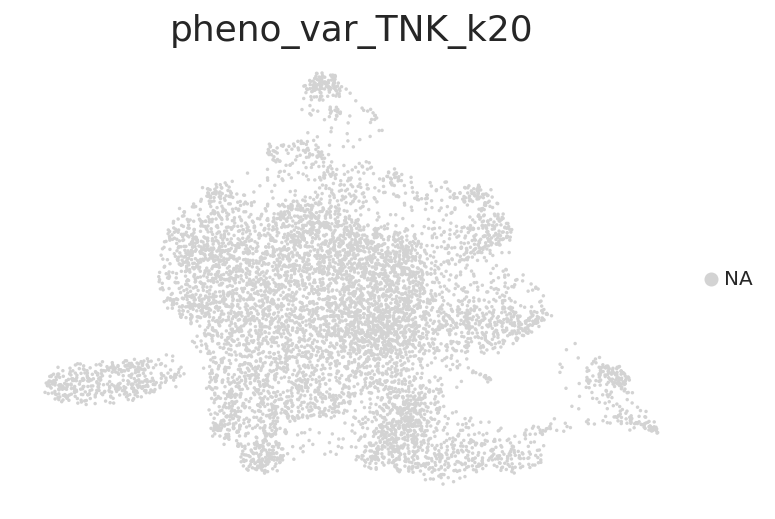

In [162]:
sc.pl.umap(adata, color = pheno_heat, groups=[19] , palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

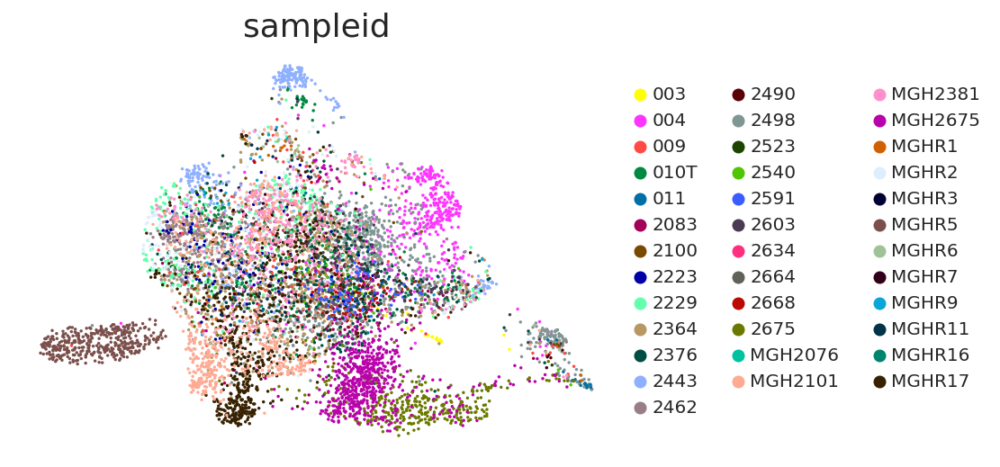

In [163]:
sc.pl.umap(adata, color = 'sampleid',
           palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

In [164]:
adata

AnnData object with n_obs × n_vars = 7714 × 13325
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF'

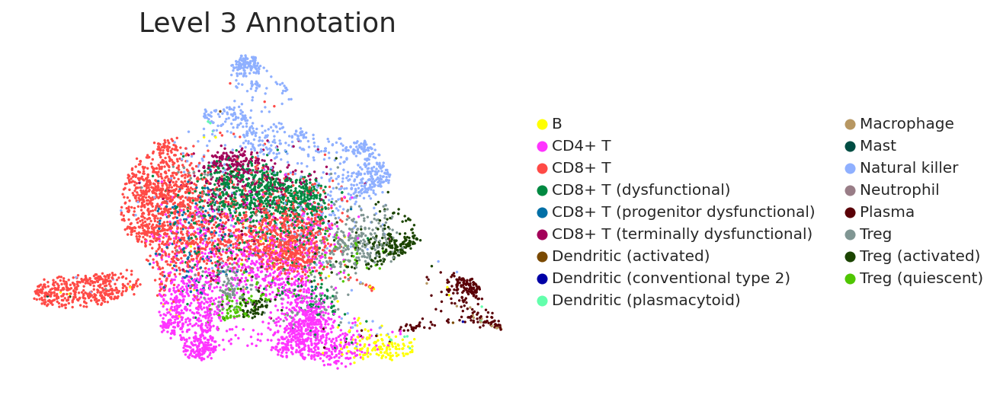

In [165]:
sc.pl.umap(adata, color = 'Level 3 Annotation',
           palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

In [166]:
set(adata.obs['Level 3 Annotation'])

{'B',
 'CD4+ T',
 'CD8+ T',
 'CD8+ T (dysfunctional)',
 'CD8+ T (progenitor dysfunctional)',
 'CD8+ T (terminally dysfunctional)',
 'Dendritic (activated)',
 'Dendritic (conventional type 2)',
 'Dendritic (plasmacytoid)',
 'Macrophage',
 'Mast',
 'Natural killer',
 'Neutrophil',
 'Plasma',
 'Treg',
 'Treg (activated)',
 'Treg (quiescent)'}

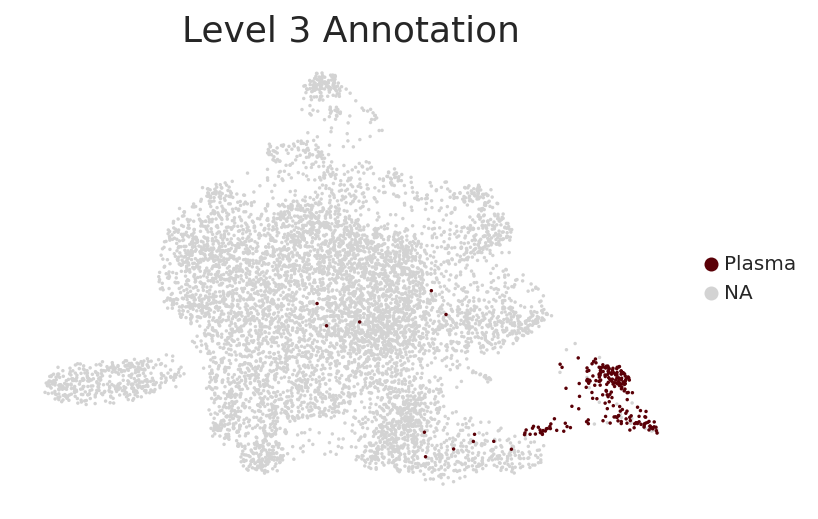

In [167]:
sc.pl.umap(adata, color = 'Level 3 Annotation',groups=[
 'Plasma',],
           palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

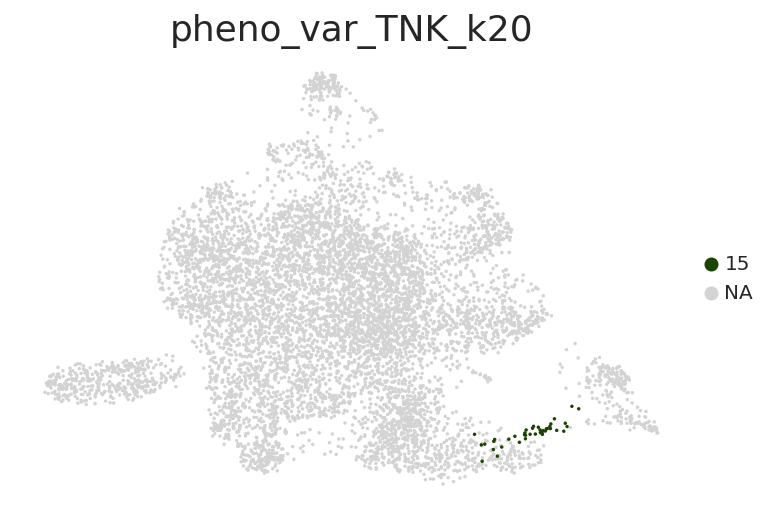

In [168]:
sc.pl.umap(adata, color = pheno_heat, groups=[15],
           palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

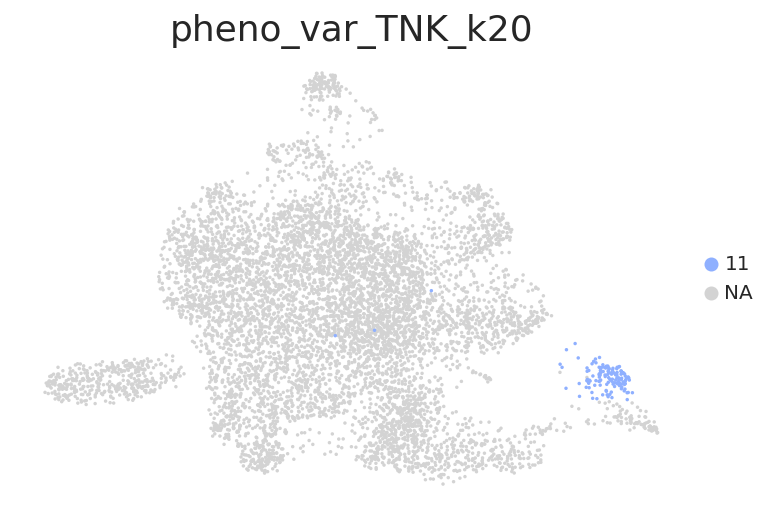

In [169]:
sc.pl.umap(adata, color = pheno_heat, groups=[11],
           palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

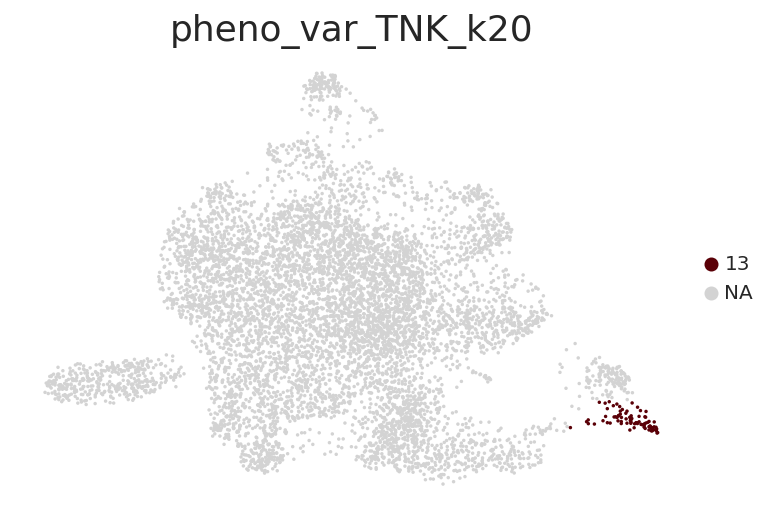

In [170]:
sc.pl.umap(adata, color = pheno_heat, groups=[13],
           palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

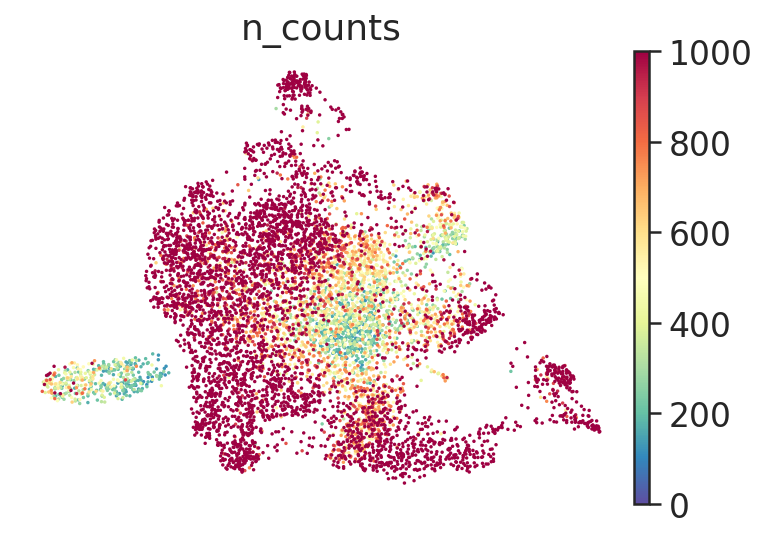

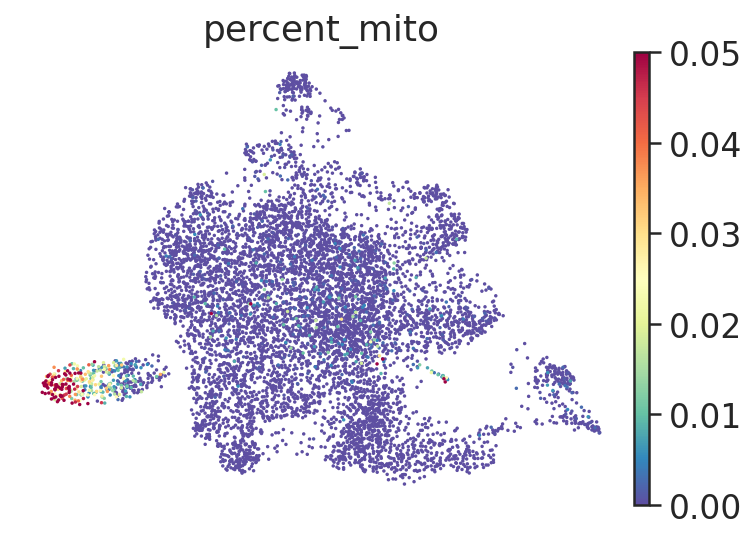

In [171]:
sc.pl.umap(adata, color = ['n_counts'],palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0,vmax=1000)
sc.pl.umap(adata, color = ['percent_mito'],palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0,vmax=.05)



In [172]:
G.identities.keys()

dict_keys(['TCM', 'TSCM', 'CD8-T_KLRG1pos-effector', 'TEM', 'FDC', 'Langerhans', 'B-memory-DN', 'Treg', 'B-memory-non-switched', 'CD56bright-NK', 'mono', 'B-pb-t1', 'NK-adaptive', 'mast', 'TRM', 'CD4-T', 'cDC2', 'p-DC', 'GC-B', 'B-memory-IgM-MZ', 'CD8-T', 'NK', 'T', 'ILC2', 'mo-DC', 'capillary', 'endo-systemic-venous', 'cDC3', 'B', 'gran', 'CD56dim-NK', 'cDC1', 'B-pb-t2', 'Lti', 'plasma', 'B-pb-mature', 'gdT', 'plasma-blast', 'CD8-T-progenitor-exhausted', 'Mac', 'B-memory-switched', 'ILC1', 'ILC3-NCRpos', 'CD8-T_KLRG1neg-effector', 'lung-endo-venous', 'ILC3-NCRneg', 'B-memory', 'endo-aerocyte', 'T-naive', 'B-naive'])

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


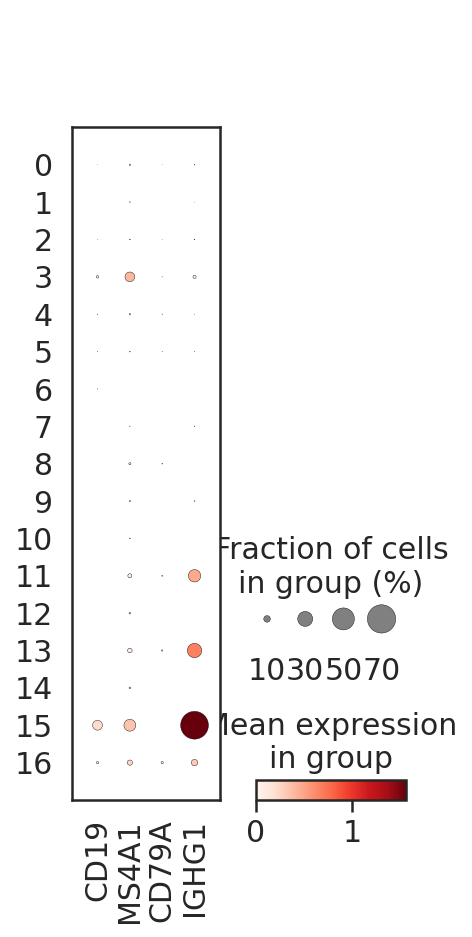

In [173]:
#dotplot
%matplotlib inline
marker_genes_filtered = ['CD19','MS4A1','CD79A','IGHG1','IGHA']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale=None)

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


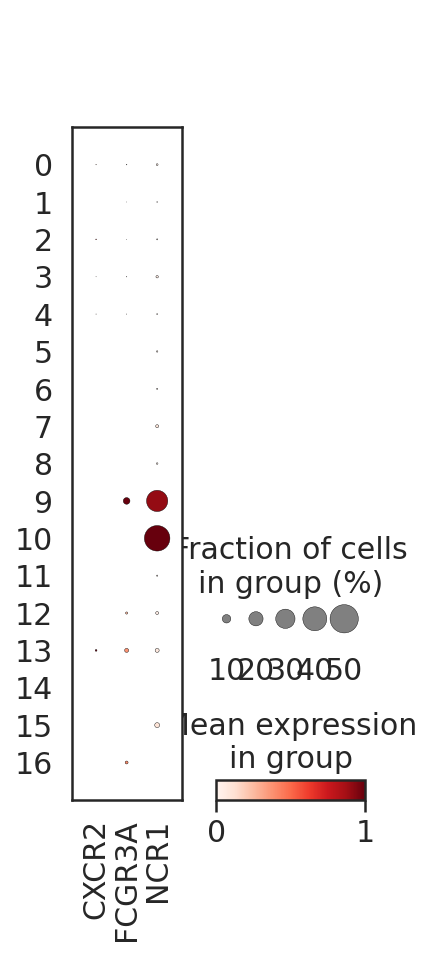

In [174]:
#dotplot
%matplotlib inline
marker_genes_filtered = ['CXCR1','CXCR2','FCGR3A','NCR1','CSF']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


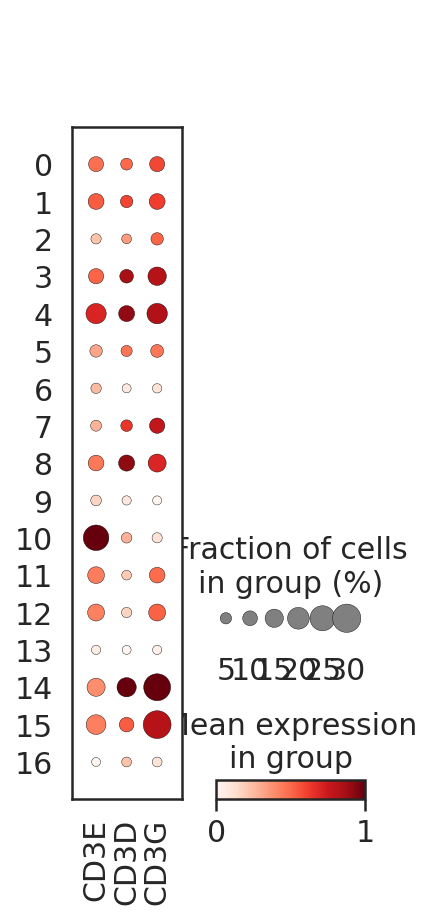

In [175]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['T']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var',smallest_dot=20)

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


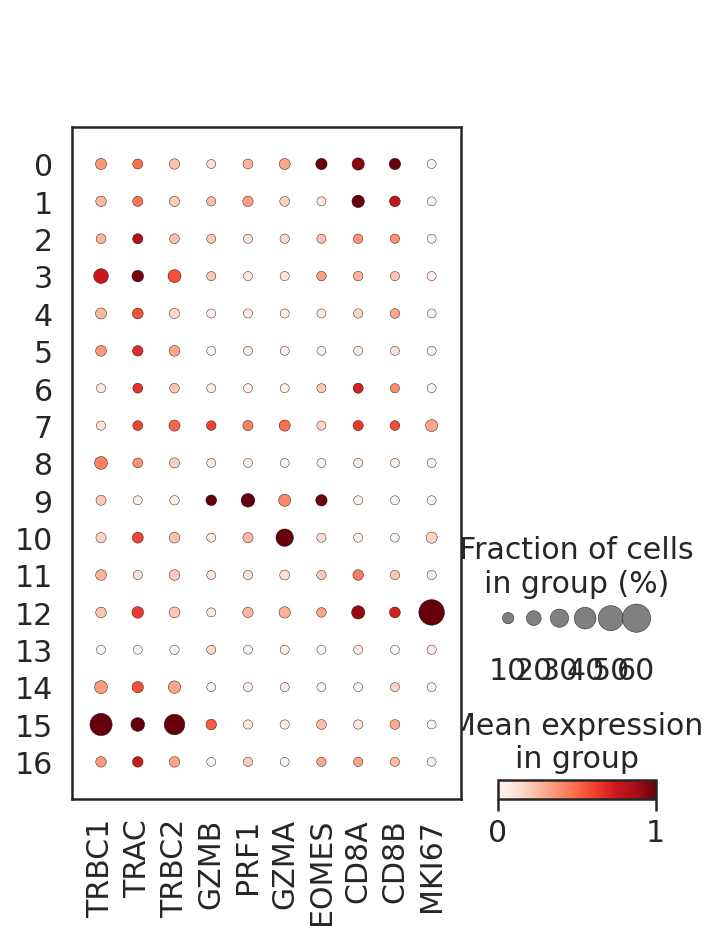

In [176]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['CD8-T']+['MKI67']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var',smallest_dot=20)

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


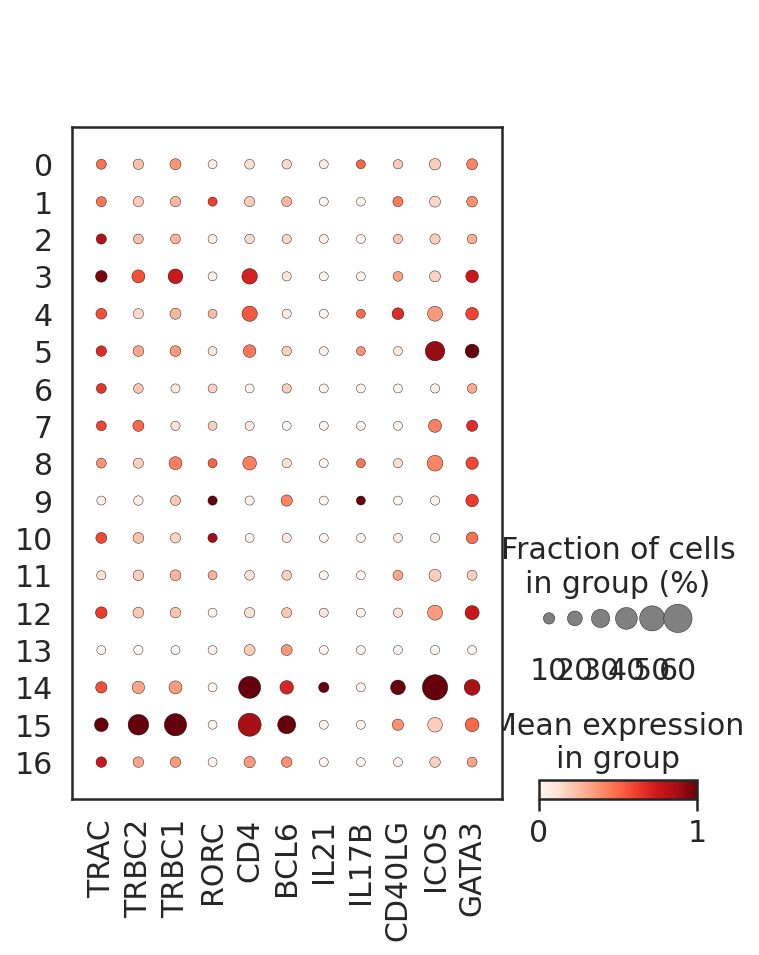

In [177]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['CD4-T']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var',smallest_dot=20)

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


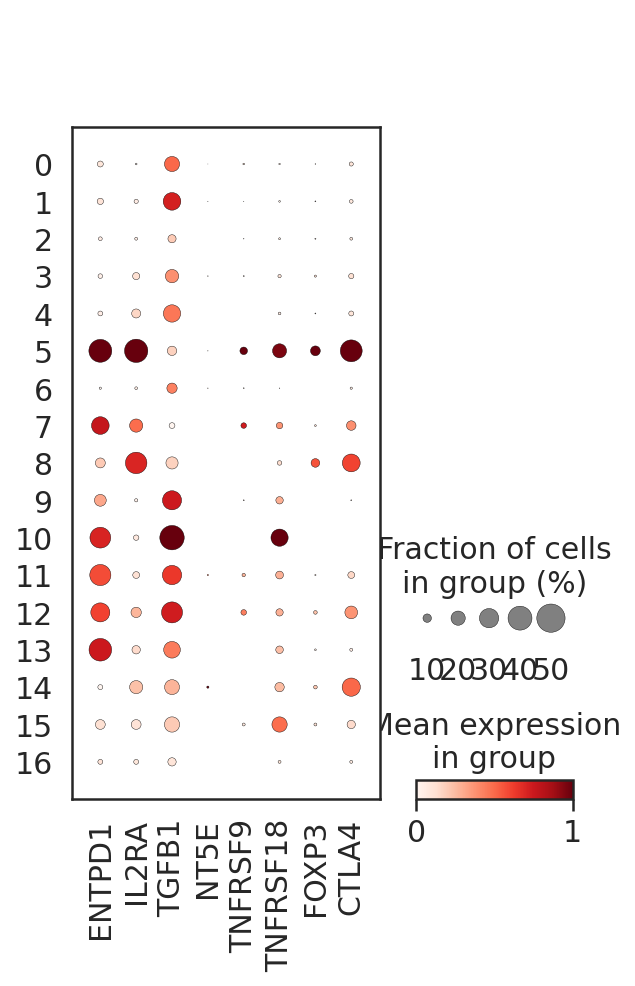

In [178]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['Treg']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

In [179]:
G.identities

{'TCM': ['S1PR4',
  'CD27',
  'CXCR3',
  'CD58',
  'CD44',
  'S1PR1',
  'IL7R',
  'CCR7',
  'ITGAL',
  'CD28',
  'SELL',
  'FAS',
  'IL2RB'],
 'TSCM': ['CD28', 'ATXN1', 'SELL', 'CD27', 'FAS', 'IL2RB', 'CCR7', 'IL7R'],
 'CD8-T_KLRG1pos-effector': ['ITGAL',
  'IFNG',
  'GZMB',
  'FAS',
  'CD58',
  'IL2RB',
  'B3GAT1',
  'KLRG1',
  'CD44'],
 'TEM': ['CD28',
  'B3GAT1',
  'IL7R',
  'CD27',
  'FAS',
  'CD58',
  'ITGAL',
  'IL2RB',
  'CD44'],
 'FDC': ['MFGE8', 'FDCSP', 'CR2', 'CR1'],
 'Langerhans': ['CDH1',
  'EPCAM',
  'TGFBR3',
  'CD1A',
  'RUNX3',
  'TACSTD2',
  'ID2',
  'LILRA4',
  'CD207',
  'TGFBR1',
  'TGFBR2'],
 'B-memory-DN': ['JCHAIN',
  'IGHA1',
  'IGHM',
  'IGHA2',
  'IGHG1',
  'IGHG3',
  'IGHG2',
  'IGHG4',
  'FCRL5',
  'ITGAX',
  'CXCR3',
  'CD24',
  'FAS'],
 'Treg': ['ENTPD1',
  'IL2RA',
  'TGFB1',
  'NT5E',
  'TNFRSF9',
  'TNFRSF18',
  'FOXP3',
  'CTLA4'],
 'B-memory-non-switched': ['IGHM',
  'JCHAIN',
  'CD1C',
  'CD38',
  'CD24',
  'IGHD',
  'CD27'],
 'CD56bright-NK': ['NCR

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


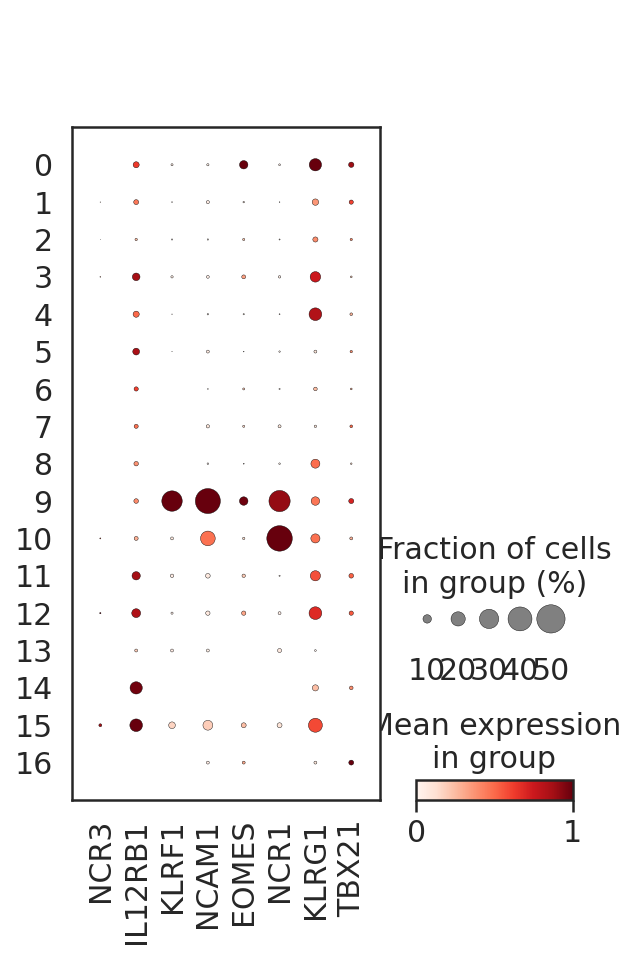

In [180]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['NK']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


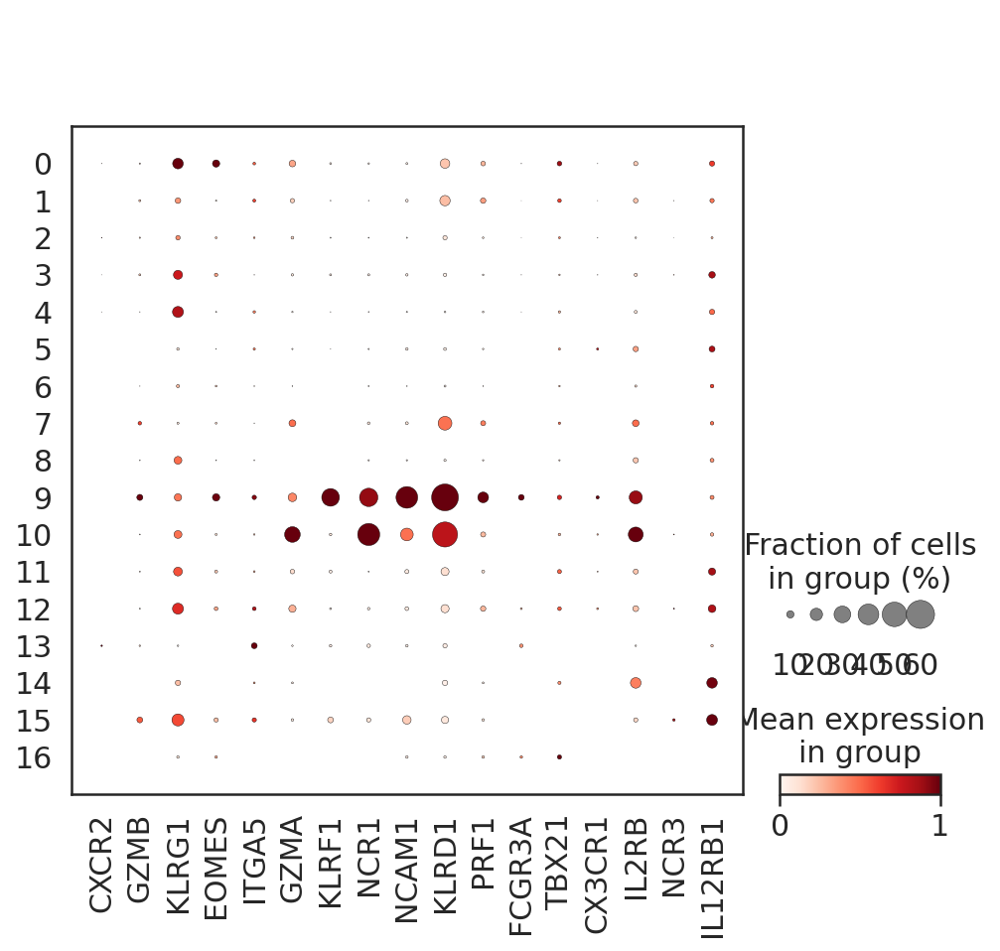

In [181]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['CD56dim-NK']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


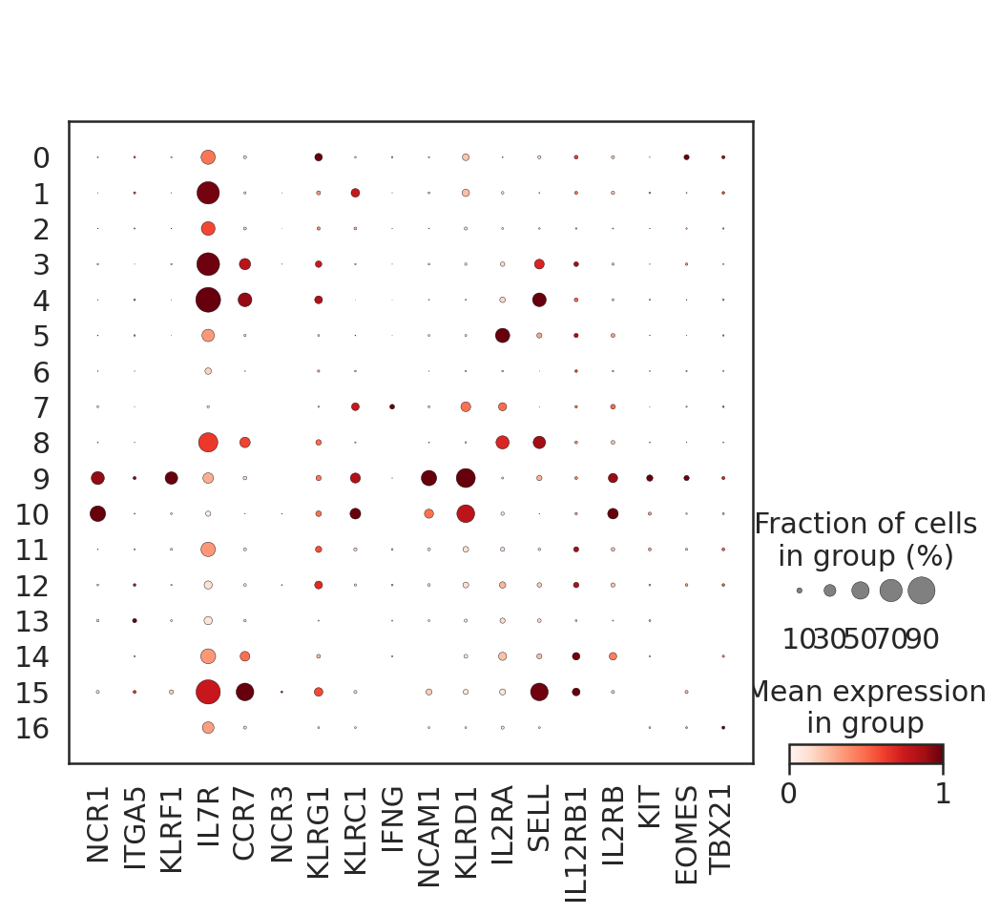

In [182]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['CD56bright-NK']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


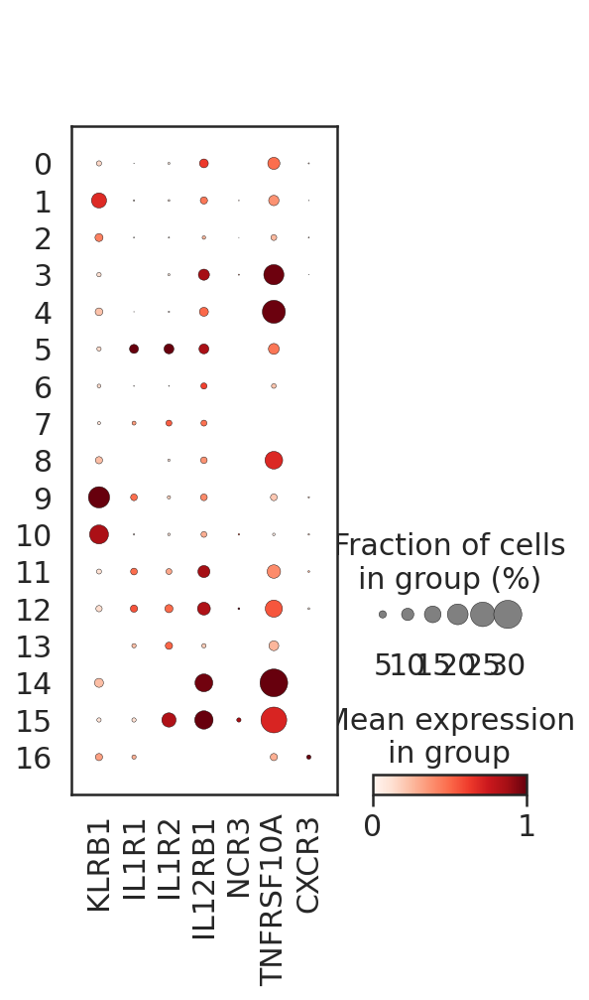

In [183]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['ILC1']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


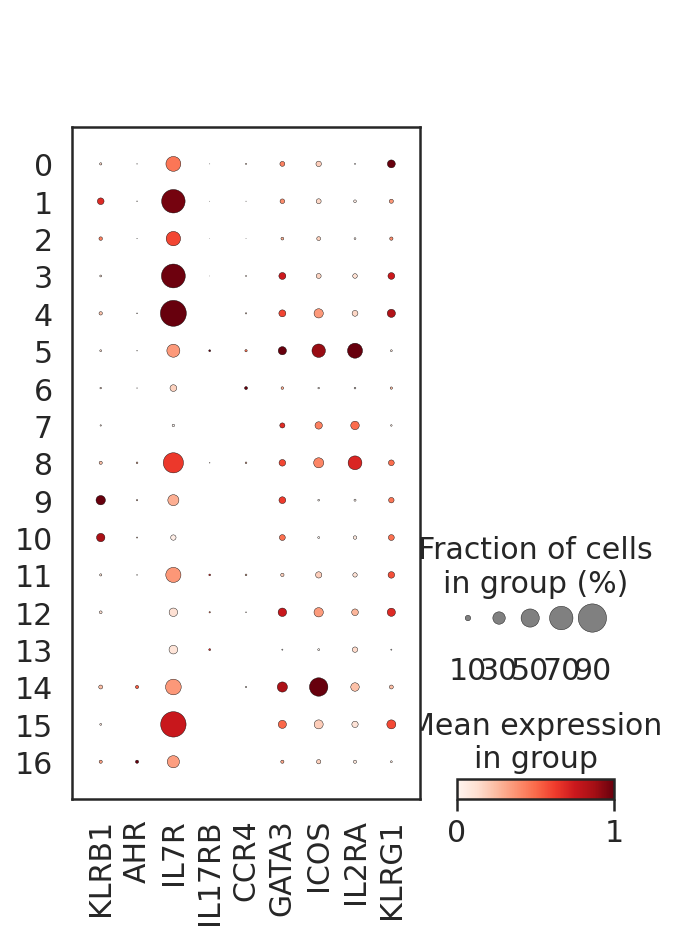

In [184]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['ILC2']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


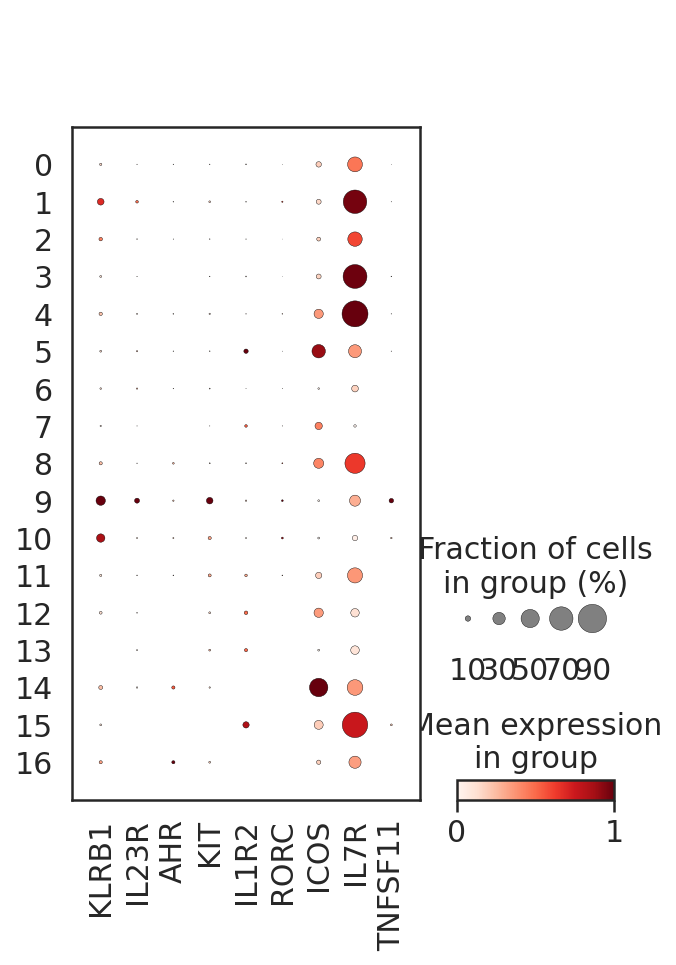

In [185]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['ILC3-NCRpos']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


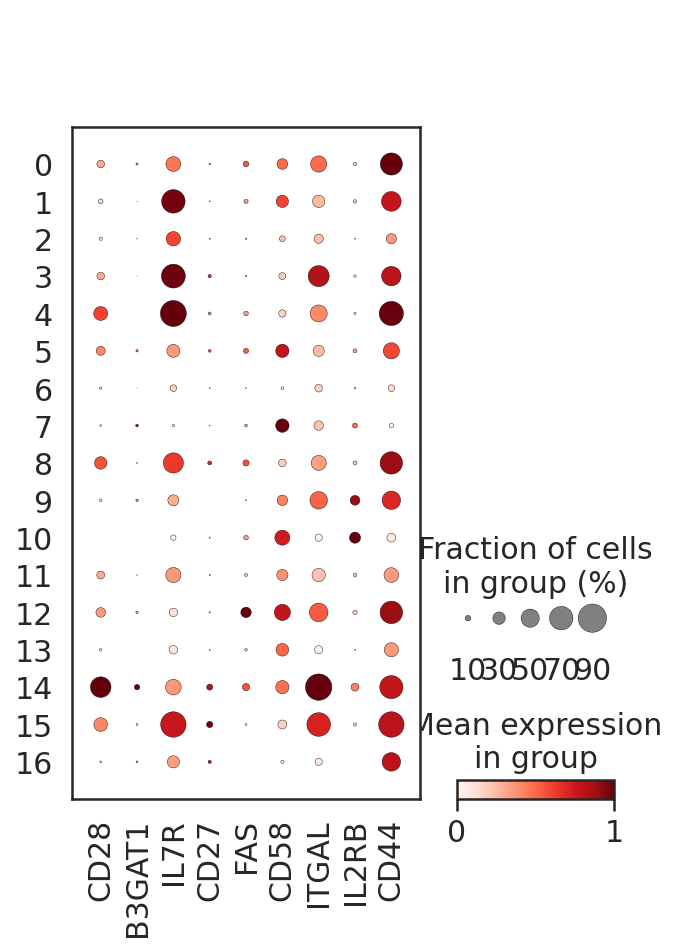

In [186]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['TEM']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

dict_keys(['TCM', 'TSCM', 'CD8-T_KLRG1pos-effector', 'TEM', 'FDC', 'Langerhans', 'B-memory-DN', 'Treg', 'B-memory-non-switched', 'CD56bright-NK', 'mono', 'B-pb-t1', 'NK-adaptive', 'mast', 'TRM', 'CD4-T', 'cDC2', 'p-DC', 'GC-B', 'B-memory-IgM-MZ', 'CD8-T', 'NK', 'T', 'ILC2', 'mo-DC', 'capillary', 'endo-systemic-venous', 'cDC3', 'B', 'gran', 'CD56dim-NK', 'cDC1', 'B-pb-t2', 'Lti', 'plasma', 'B-pb-mature', 'gdT', 'plasma-blast', 'CD8-T-progenitor-exhausted', 'Mac', 'B-memory-switched', 'ILC1', 'ILC3-NCRpos', 'CD8-T_KLRG1neg-effector', 'lung-endo-venous', 'ILC3-NCRneg', 'B-memory', 'endo-aerocyte', 'T-naive', 'B-naive'])

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


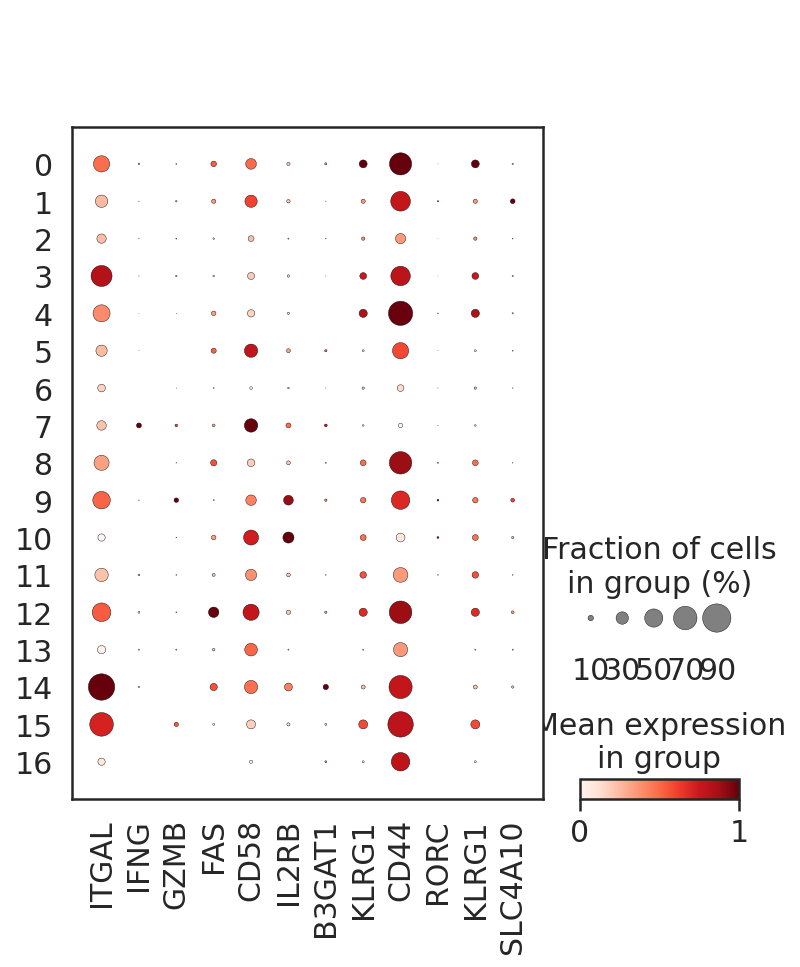

In [203]:
#dotplot
%matplotlib inline
marker_genes_filtered =G.identities['CD8-T_KLRG1pos-effector']+ ['RORC','KLRG1', 'SLC4A10']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


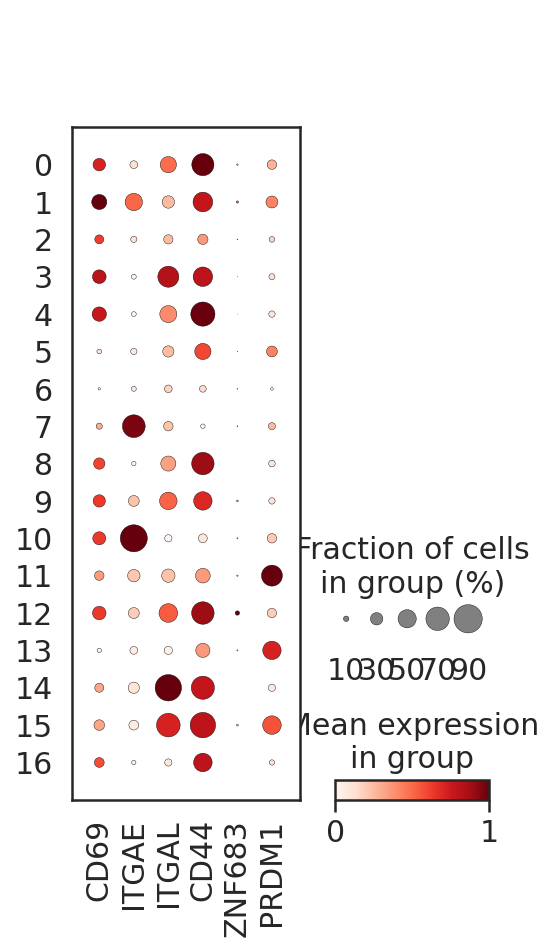

In [198]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['TRM']+['ZNF683','PRDM1']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


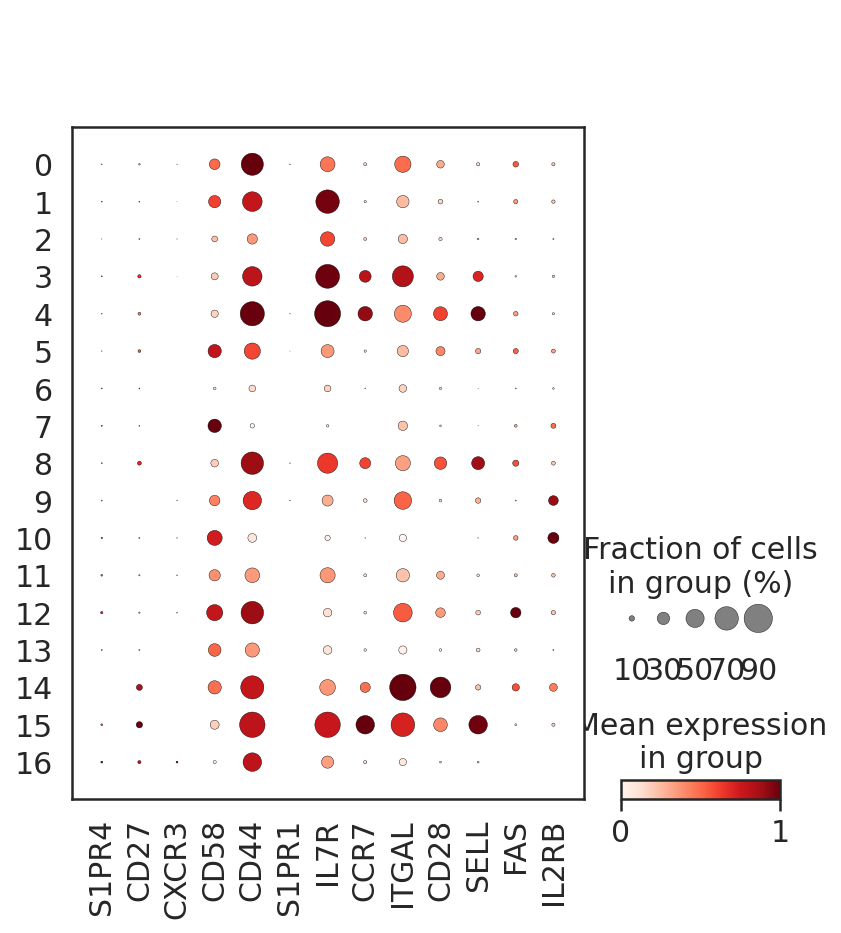

In [188]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['TCM']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


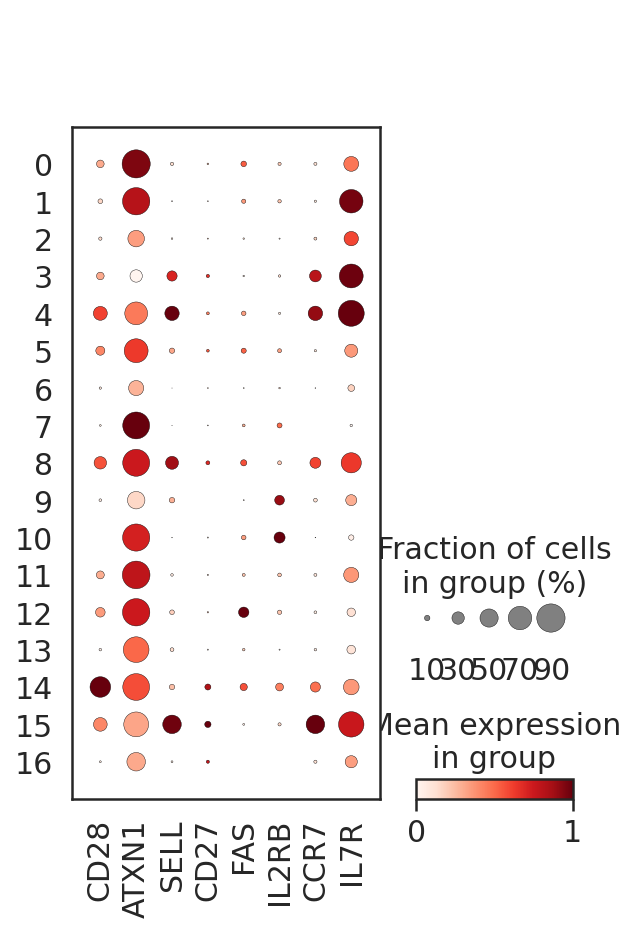

In [189]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['TSCM']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

In [190]:
G.identities.keys()


dict_keys(['TCM', 'TSCM', 'CD8-T_KLRG1pos-effector', 'TEM', 'FDC', 'Langerhans', 'B-memory-DN', 'Treg', 'B-memory-non-switched', 'CD56bright-NK', 'mono', 'B-pb-t1', 'NK-adaptive', 'mast', 'TRM', 'CD4-T', 'cDC2', 'p-DC', 'GC-B', 'B-memory-IgM-MZ', 'CD8-T', 'NK', 'T', 'ILC2', 'mo-DC', 'capillary', 'endo-systemic-venous', 'cDC3', 'B', 'gran', 'CD56dim-NK', 'cDC1', 'B-pb-t2', 'Lti', 'plasma', 'B-pb-mature', 'gdT', 'plasma-blast', 'CD8-T-progenitor-exhausted', 'Mac', 'B-memory-switched', 'ILC1', 'ILC3-NCRpos', 'CD8-T_KLRG1neg-effector', 'lung-endo-venous', 'ILC3-NCRneg', 'B-memory', 'endo-aerocyte', 'T-naive', 'B-naive'])

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


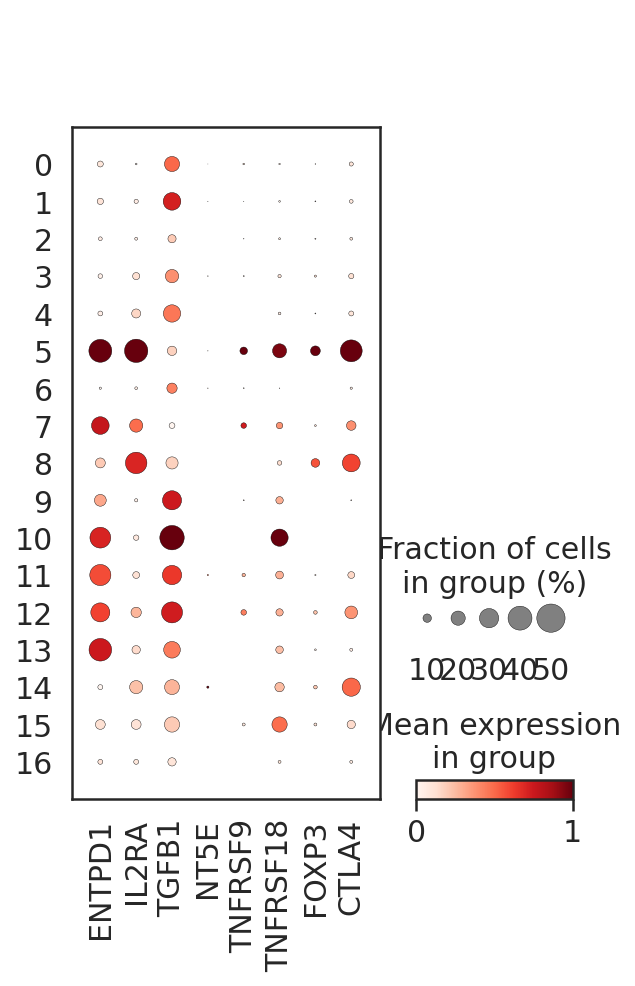

In [191]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['Treg']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


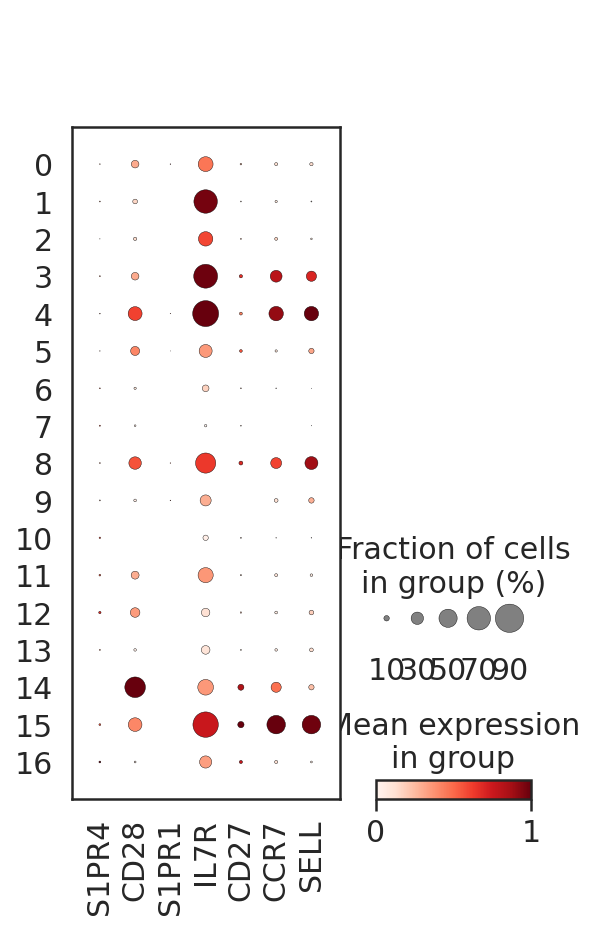

In [192]:
#dotplot
%matplotlib inline
marker_genes_filtered = G.identities['T-naive']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


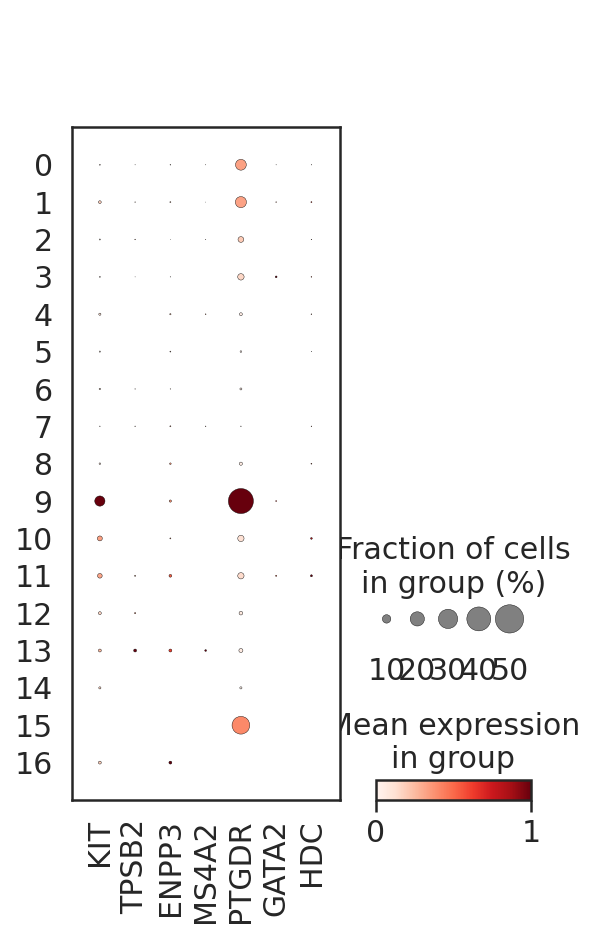

In [193]:
#dotplot
marker_genes_filtered = G.identities['mast']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale='var')

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


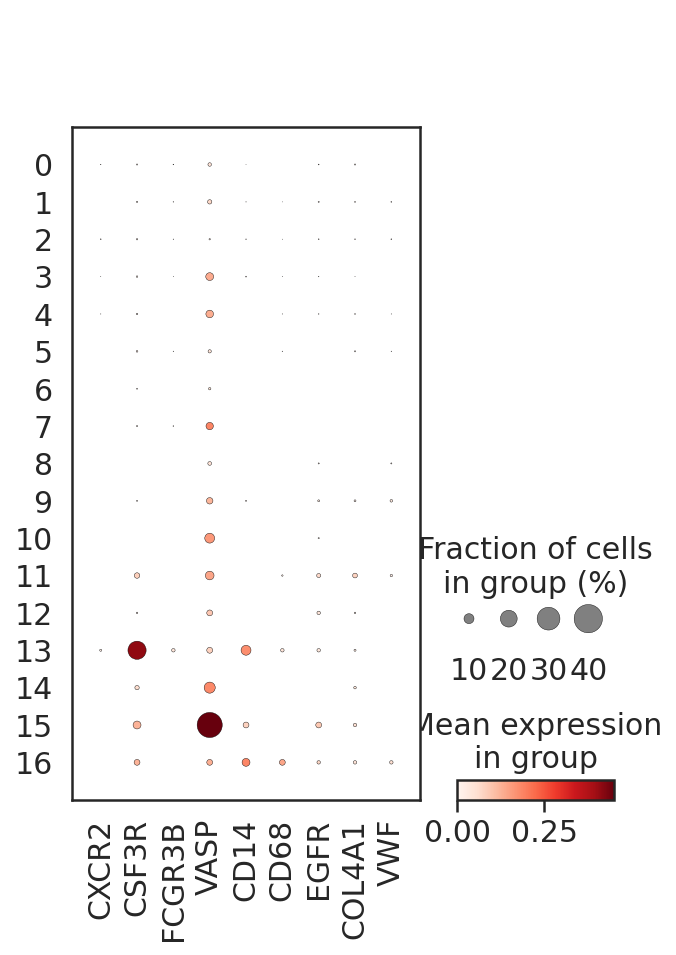

In [194]:
#dotplot
marker_genes_filtered = G.identities['gran']+['CD14','CD68','EGFR','COL4A1','VWF','JAM2']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale=None)

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


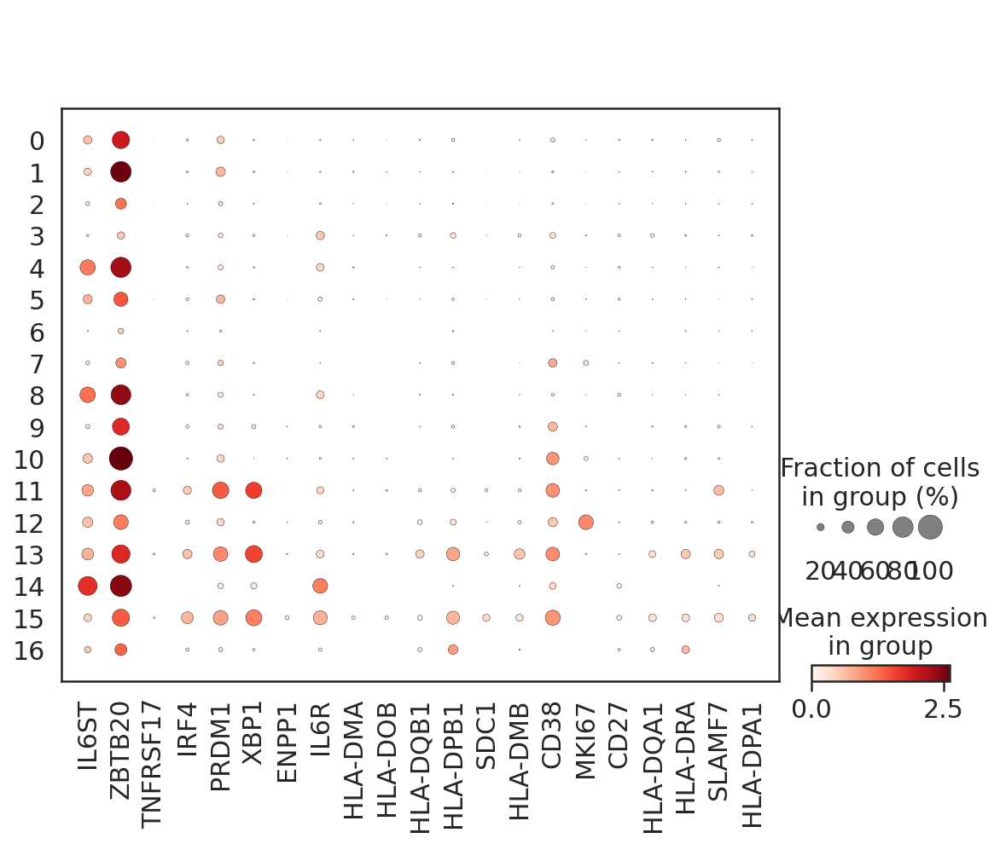

In [195]:
#dotplot
marker_genes_filtered = G.identities['plasma']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale=None)

    using 'X_pca' with n_pcs = 63
Storing dendrogram info using `.uns['dendrogram_pheno_var_TNK_k20']`


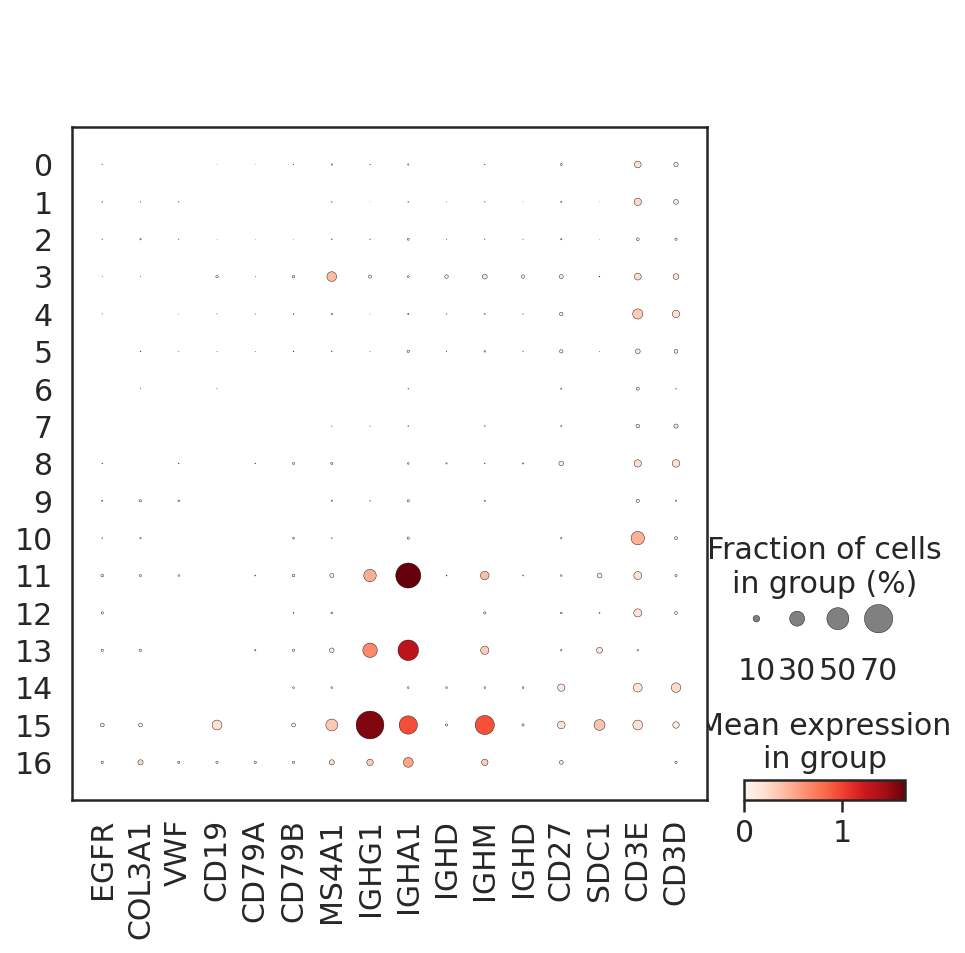

In [196]:
#dotplot
marker_genes_filtered = ['EPCAM','EGFR','COL3A1','JAM2','VWF',
                        'CD19','CD79A','CD79B','MS4A1','IGHG1','IGHA1','IGHD','IGHM','IGHD',
                        'CD27','SDC1','CD3E','CD3D']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale=None)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


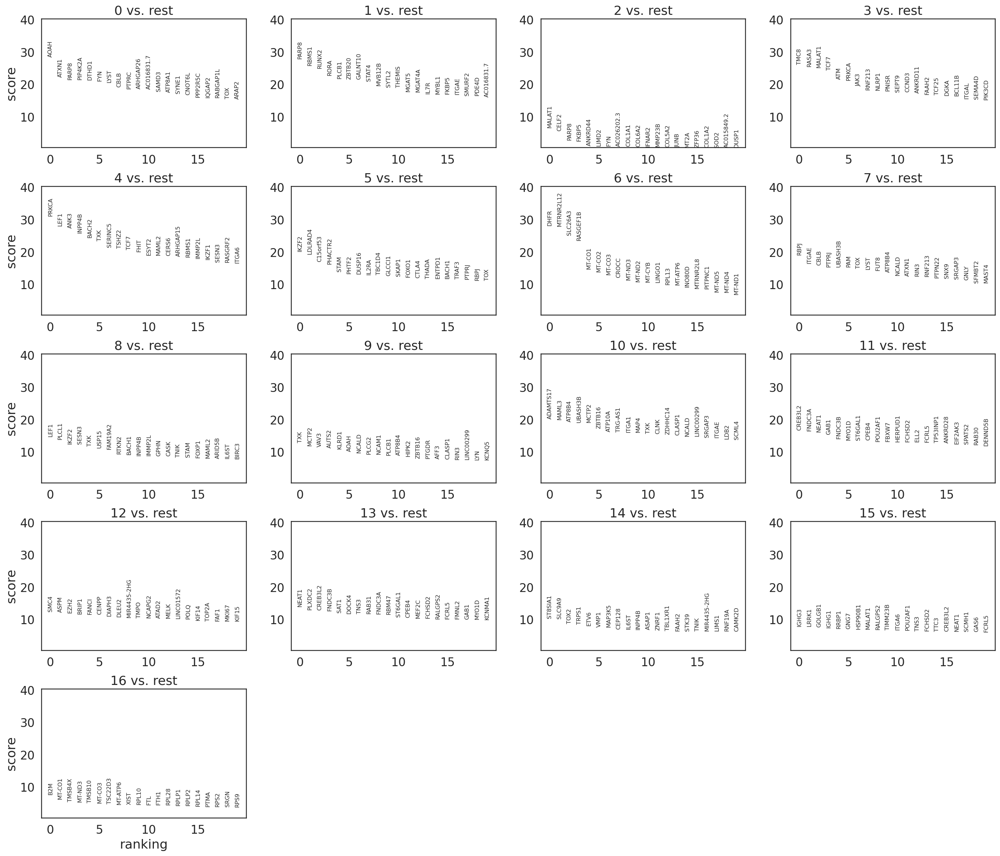

In [197]:
sc.tl.rank_genes_groups(adata, pheno_heat, method='wilcoxon')
sc.pl.rank_genes_groups(adata)

In [17]:
pheno_heat = 'pheno_var_TNK_k20'

In [18]:
annotation_dict = {0:'CD8-T_KLRG1pos-effector',
                  1:'CD8-TRM',
                  2:'T',
                  3:'CD4-T-naive',
                  4:'CD4-T-naive',
                  5:'Treg',
                  6:'CD8-T',
                  7:'CD8-T',
                  8:'CD4-T-naive',
                  9:'NK',
                  10:'NK',
                  11:'B-T_doublet',
                  12:'T_proliferating',
                  13:'plasma',
                  14:'CD4-TSCM_TFH',
                  15:'B-T_doublet',
                  16:'T'  }

In [19]:
pheno_heat

'pheno_var_TNK_k20'

In [32]:
adata.obs['annotation'] = adata.obs['pheno_var_TNK_k20'].map(annotation_dict)
set(adata.obs['annotation'])

{'B-T_doublet',
 'CD4-T-naive',
 'CD4-TSCM_TFH',
 'CD8-T',
 'CD8-TRM',
 'CD8-T_KLRG1pos-effector',
 'NK',
 'T',
 'T_proliferating',
 'Treg',
 'plasma'}

In [33]:
adata.obs['pheno_annotate'] = ['TNK_'+str(x) for x in adata.obs['pheno_var_TNK_k20']]
set(adata.obs['pheno_annotate'])

{'TNK_0',
 'TNK_1',
 'TNK_10',
 'TNK_11',
 'TNK_12',
 'TNK_13',
 'TNK_14',
 'TNK_15',
 'TNK_16',
 'TNK_2',
 'TNK_3',
 'TNK_4',
 'TNK_5',
 'TNK_6',
 'TNK_7',
 'TNK_8',
 'TNK_9'}

In [34]:
set(adata.obs['pheno_var_TNK_k10']==16)

{False, True}

In [35]:
new_annotations = []
new_pheno_annotate = []

old_annotations = list(adata.obs['annotation'])
old_pheno = list(adata.obs['pheno_annotate'])

for i,v in enumerate(list(adata.obs['pheno_var_TNK_k10'])):
    if v==16:
        new_pheno_annotate.append('TNK_pheno_var_TNK_k10_16')
        new_annotations.append('B-T_doublet')
    else:
        new_pheno_annotate.append(old_pheno[i])
        new_annotations.append(old_annotations[i])
        
adata.obs['annotation'] = new_annotations
adata.obs['pheno_annotate'] = new_pheno_annotate

In [36]:
set(adata.obs['pheno_annotate'])

{'TNK_0',
 'TNK_1',
 'TNK_10',
 'TNK_11',
 'TNK_12',
 'TNK_13',
 'TNK_14',
 'TNK_15',
 'TNK_16',
 'TNK_2',
 'TNK_3',
 'TNK_4',
 'TNK_5',
 'TNK_6',
 'TNK_7',
 'TNK_8',
 'TNK_9',
 'TNK_pheno_var_TNK_k10_16'}

In [37]:
set(adata.obs['annotation'])

{'B-T_doublet',
 'CD4-T-naive',
 'CD4-TSCM_TFH',
 'CD8-T',
 'CD8-TRM',
 'CD8-T_KLRG1pos-effector',
 'NK',
 'T',
 'T_proliferating',
 'Treg',
 'plasma'}

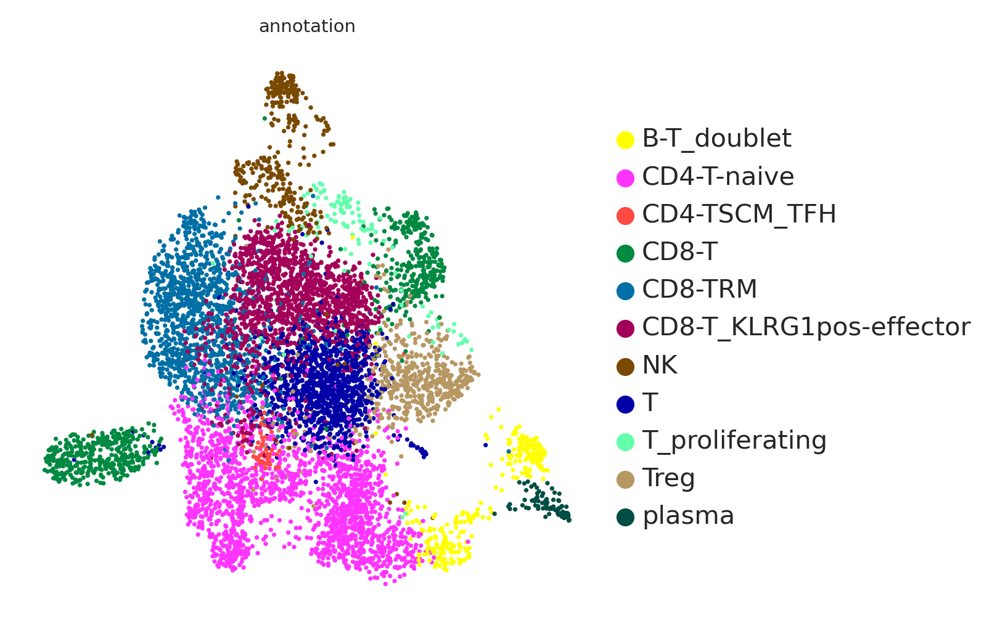

In [38]:
sc.pl.umap(adata, color = 'annotation',
           palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

In [39]:
adata.write(DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_2500hv.h5ad')

In [8]:
adata = sc.read(DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_2500hv.h5ad')
adata

AnnData object with n_obs × n_vars = 7714 × 13325
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF'

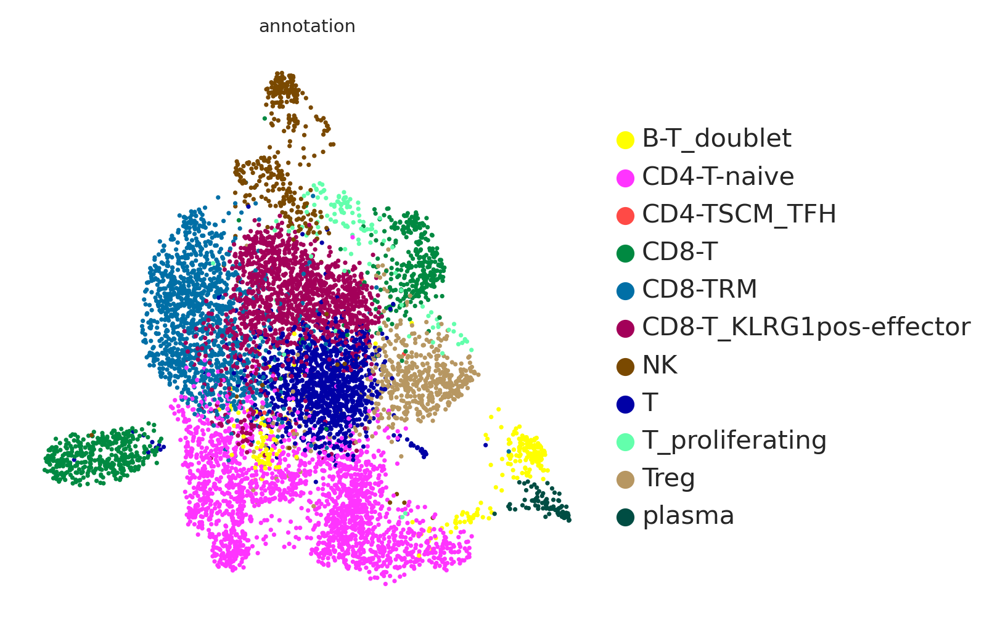

In [9]:
sc.pl.umap(adata, color = ['annotation'],palette=color_map_clusters_nogrey, s = 12, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0,vmax=.05)


## analyze ILCs

In [330]:
adata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_2500hv.h5ad'
adata_save_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_2500hv_ILC_{}.h5ad'
immune_markers_path = '/data/peer/wallet/Jupyter/2023_Particle_SASP/2023_Particle_SASP/'+'immune_marker_panel_clean_210216.csv'
marker_gene_path = '/data/peer/wallet/Jupyter/2023_Particle_SASP/2023_Particle_SASP/230529_marker_genes_hv.csv'
marker_gene_sets =[ 'ILC_important_marker',]#'B_important_marker','M_important_marker', 'DC_important_marker',
use_hv_genes = True
add_marker_genes=True
number_of_hv_genes = 2500


pheno_names = ['pheno_var_ILC_k10','pheno_var_ILC_k20','pheno_var_ILC_k30','pheno_var_ILC_k40','pheno_var_ILC_k50','pheno_var_ILC_k60',
               'pheno_var_ILC_k70',
              'pheno_var_ILC_k80','pheno_var_ILC_k90','pheno_var_ILC_k100']

#pheno_names = ['pheno_k10','pheno_k20','pheno_k30','pheno_k40','pheno_k50','pheno_k60','pheno_k70',
 #             'pheno_k80','pheno_k90','pheno_k100']
pheno_ks = [10,20,30,40,50,60,70,80,90,100]

min_cells_per_gene = 2

min_gene_number = 50

In [ ]:
adata = sc.read(adata_path)
adata

In [332]:
adata = adata[adata.obs['pheno_var_TNK_k20'].isin([9,10])]
adata

View of AnnData object with n_obs × n_vars = 342 × 13325
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 

In [276]:
sc.pp.filter_genes(adata, min_cells=min_cells_per_gene)

filtered out 2353 genes that are detected in less than 2 cells


/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


In [277]:
sc.pp.filter_cells(adata, min_genes= min_gene_number)


In [278]:
adata

AnnData object with n_obs × n_vars = 342 × 10972
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF',

In [279]:
if use_hv_genes:
    sc.pp.highly_variable_genes(adata,  flavor='cell_ranger', n_top_genes=number_of_hv_genes)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [280]:
number_of_hv_genes

2500

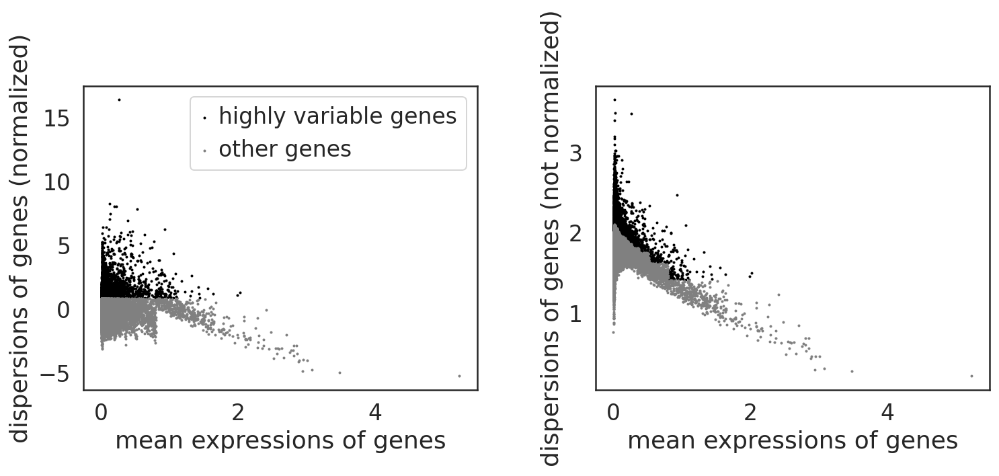

In [281]:
if use_hv_genes:
    sc.pl.highly_variable_genes(adata,  show=None, save=None, highly_variable_genes=True)

In [282]:
if add_marker_genes and use_hv_genes:
    marker_genes_df = pd.read_csv(immune_markers_path,index_col=['gene_name'])


In [283]:
#limit to human only
if add_marker_genes and use_hv_genes:
    marker_genes_df = marker_genes_df[marker_genes_df['species'] == 'homo_sapiens']
    marker_genes_df

In [284]:
#limit to markers used for distinguishing immune cells
if add_marker_genes and use_hv_genes:
    marker_genes_df = marker_genes_df[marker_gene_sets]
    marker_genes_df

In [285]:
#extract gene names
if add_marker_genes and use_hv_genes:
    marker_lists = []
    for i in marker_gene_sets:
        marker_genes_list = list(set(marker_genes_df[marker_genes_df[i]==True].index))
        marker_lists.append(marker_genes_list)
    marker_lists

In [286]:
#concatenate lists
if add_marker_genes and use_hv_genes:
    import itertools
    a = marker_lists
    marker_genes = list(itertools.chain.from_iterable(a))
    marker_genes

In [287]:
#set important marker genes as highly variable
if add_marker_genes and use_hv_genes:
    for i in marker_genes:
        if i in adata.var_names:
            adata.var['highly_variable'][i]= True
        else:
            print(i, 'not found')

HLA-DRB3 not found
MYC not found
HLA-DRB4 not found


/scratch/lsftmp/18730078.tmpdir/ipykernel_223871/4083173082.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var['highly_variable'][i]= True


In [288]:
adata[:,'FASLG'].var['highly_variable']

FASLG    True
Name: highly_variable, dtype: bool

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:00)


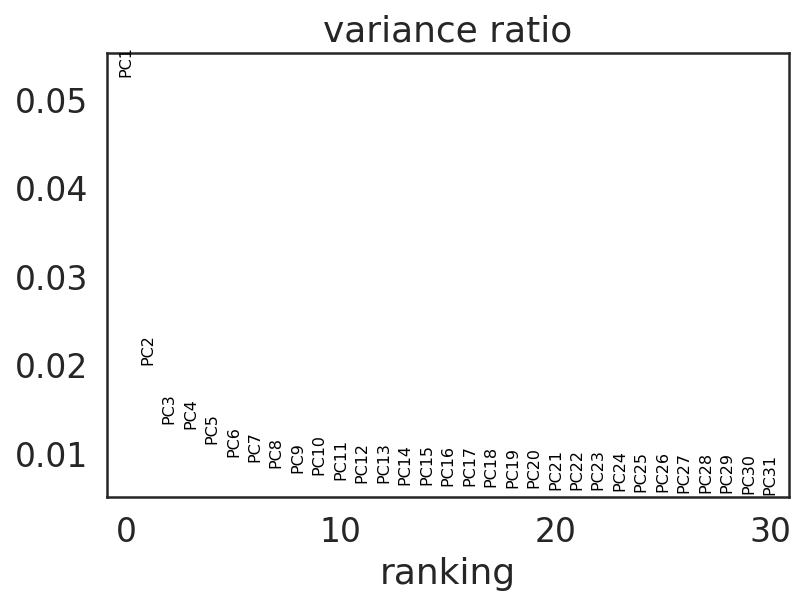

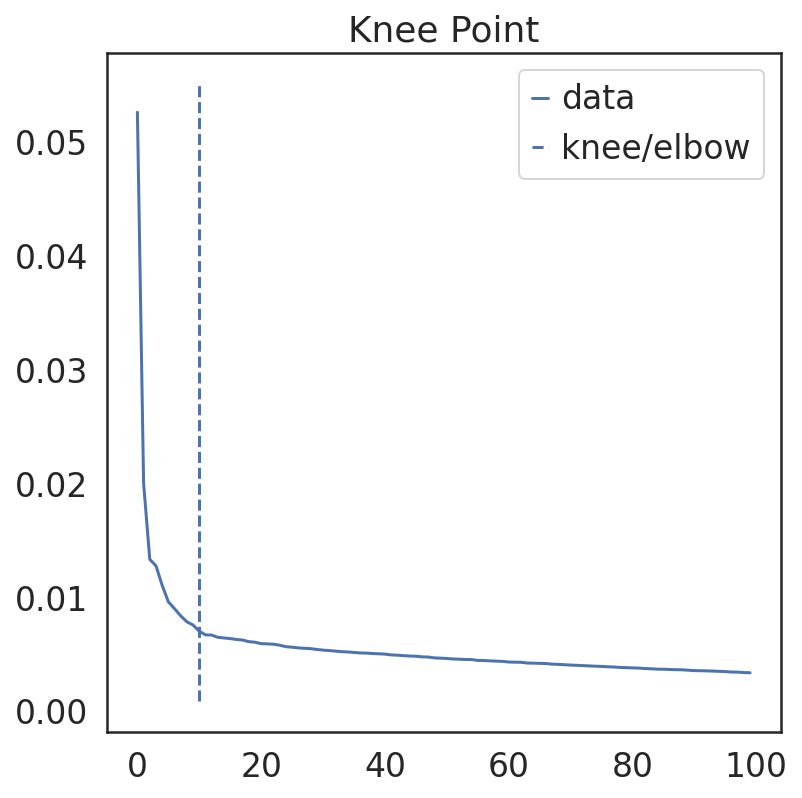

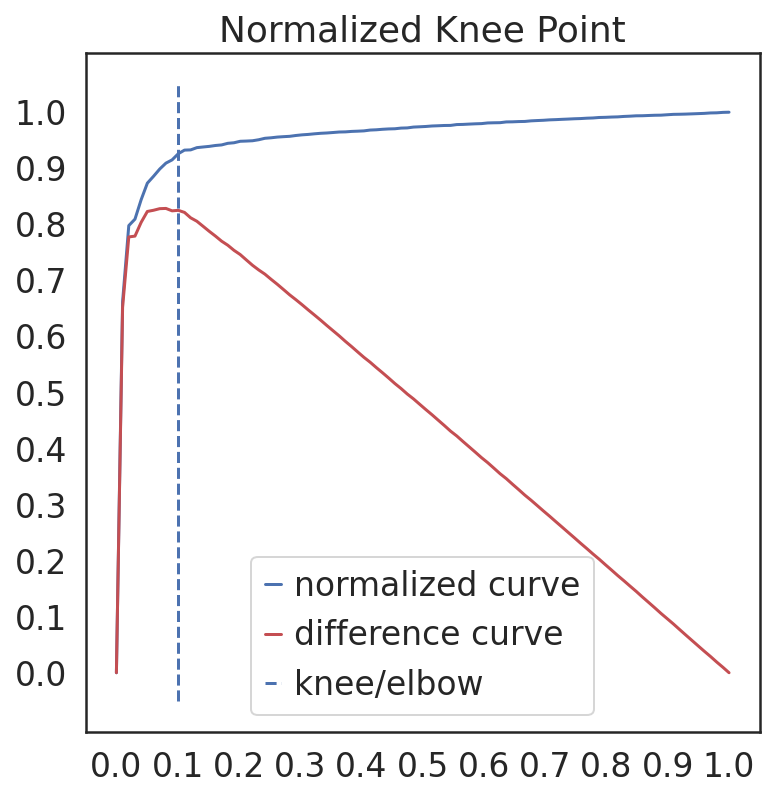

Kneepoint happens at PC: 10
10 PC explain 15.23841586895287 % of variance
2 PC explain 7.2683606296777725 % of variance
3 PC explain 8.603902626782656 % of variance
4 PC explain 9.882579185068607 % of variance
5 PC explain 10.990307852625847 % of variance
6 PC explain 11.952865403145552 % of variance
7 PC explain 12.855108454823494 % of variance
8 PC explain 13.69365118443966 % of variance
9 PC explain 14.480327907949686 % of variance
10 PC explain 15.23841586895287 % of variance
11 PC explain 15.942293172702193 % of variance
12 PC explain 16.614616801962256 % of variance
13 PC explain 17.28487443178892 % of variance
14 PC explain 17.935477988794446 % of variance
15 PC explain 18.580309068784118 % of variance
16 PC explain 19.219788210466504 % of variance
17 PC explain 19.8514174669981 % of variance
18 PC explain 20.47810358926654 % of variance
19 PC explain 21.09068399295211 % of variance
20 PC explain 21.698347432538867 % of variance
21 PC explain 22.293046535924077 % of variance
22 

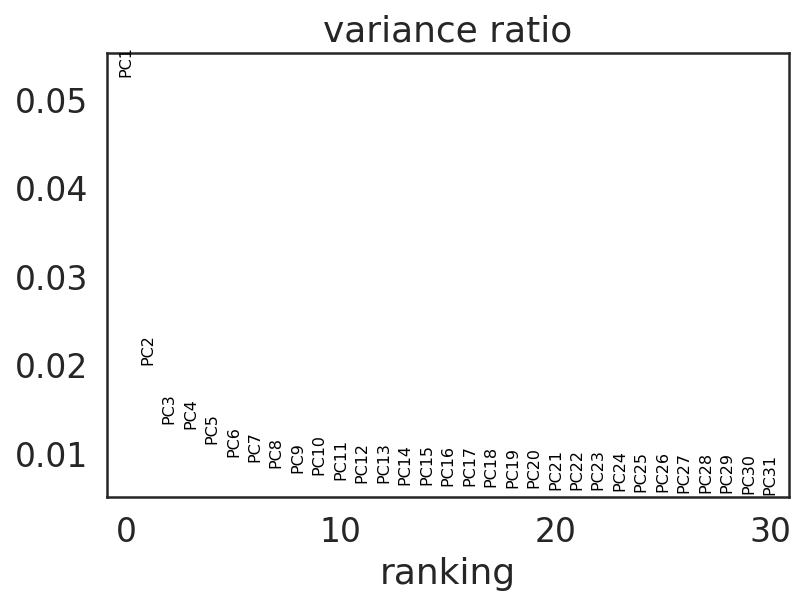

In [289]:
if use_hv_genes:
    number_of_PC_used = calculate_optimal_PC(adata, min_PC = 50, min_var=25, n_comps=100, use_hv=True)
else:
    number_of_PC_used = calculate_optimal_PC(adata, min_PC = 50, min_var=25, n_comps=100, use_hv=False)

In [290]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=number_of_PC_used)
sc.tl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


In [291]:
for i,v in enumerate(pheno_names):
    result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = pheno_ks[i], seed=1)
    adata.obs[v] = pd.Categorical(result_pheno_ndf_all[0])

PhenoGraph clustering
Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.08486294746398926 seconds
Jaccard graph constructed in 3.1915884017944336 seconds
Wrote graph to binary file in 0.0053594112396240234 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.703822
Louvain completed 21 runs in 0.1279129981994629 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 6.487698554992676 seconds
    finished (0:00:06)
PhenoGraph clustering
Finding 20 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.06057381629943848 seconds
Jaccard graph constructed in 3.1142382621765137 seconds
Wrote graph to binary file in 0.007997751235961914 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.600913
After 3 runs, maximum modularity is Q = 0.602211
Louvain completed 23 runs in 0.14964532852172852 seconds
Sorting communities b

In [292]:
#impute data
adata_indf = magic(adata, copy=True, verbose=True, solver='exact', n_pca=adata.obsm['X_pca'].shape[1], knn=5, t=3)
adata.layers['imputed'] = adata_indf.X

computing MAGIC
Calculating MAGIC...
  Running MAGIC on 342 cells and 10972 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.90 seconds.
    Calculating KNN search...
    Calculating affinities...
    Calculated affinities in 0.01 seconds.
  Calculated graph and diffusion operator in 0.93 seconds.
  Running MAGIC with `solver='exact'` on 10972-dimensional data may take a long time. Consider denoising specific genes with `genes=<list-like>` or using `solver='approximate'`.
  Calculating imputation...
  Calculated imputation in 0.05 seconds.
Calculated MAGIC in 0.99 seconds.
    finished (0:00:01)


In [293]:
adata_save_path.format(str(number_of_hv_genes))

'/data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_2500hv_ILC_2500.h5ad'

In [294]:
adata.write(adata_save_path.format(str(number_of_hv_genes)))
print('saved data to:',adata_save_path.format(str(number_of_hv_genes)))

saved data to: /data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_2500hv_ILC_2500.h5ad


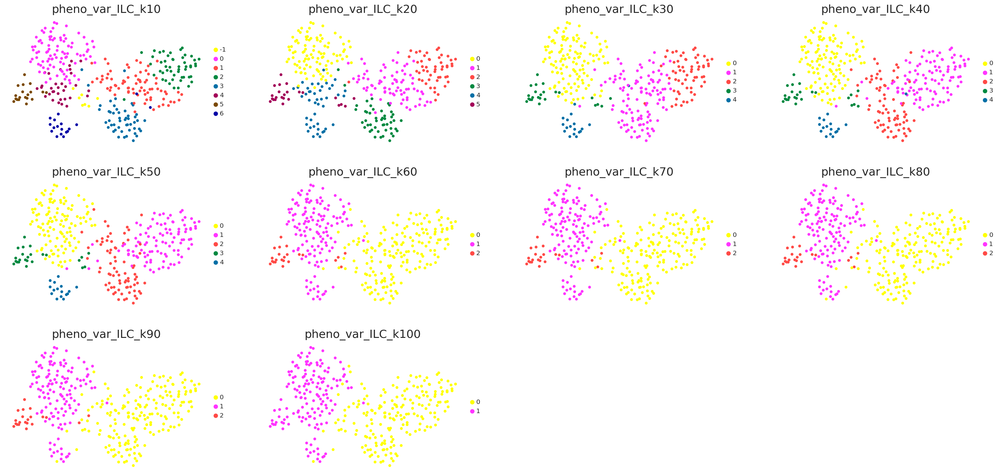

In [295]:
sc.pl.umap(adata, color = pheno_names, 
           palette=color_map_clusters_nogrey, s = 80, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

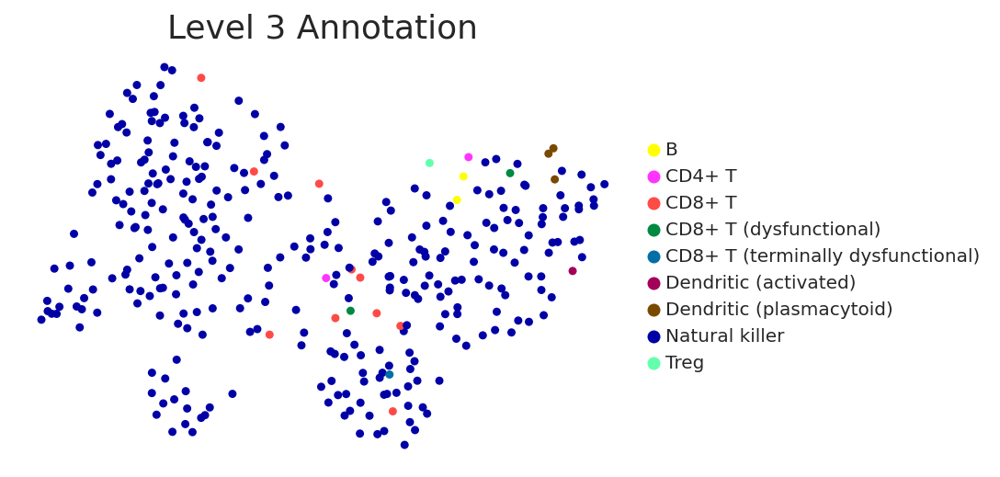

In [296]:
sc.pl.umap(adata, color = 'Level 3 Annotation', 
           palette=color_map_clusters_nogrey, s = 80, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

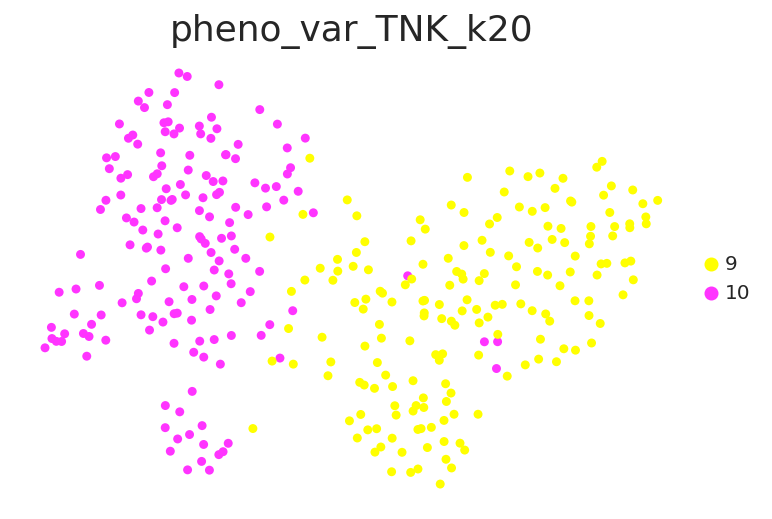

In [297]:
sc.pl.umap(adata, color = 'pheno_var_TNK_k20', 
           palette=color_map_clusters_nogrey, s = 80, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)

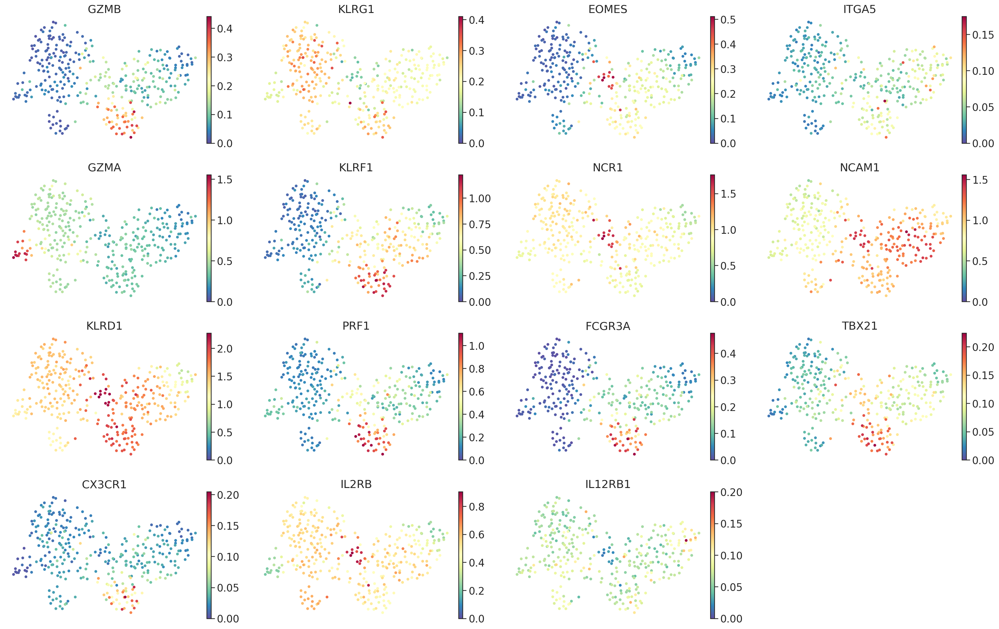

In [298]:
genes_oi = [x for x in list(G.identities['CD56dim-NK']) if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, 
           palette=color_map_clusters_nogrey, s = 80, cmap= 'Spectral_r', layer='imputed',legend_fontsize = 10, vmin=0)

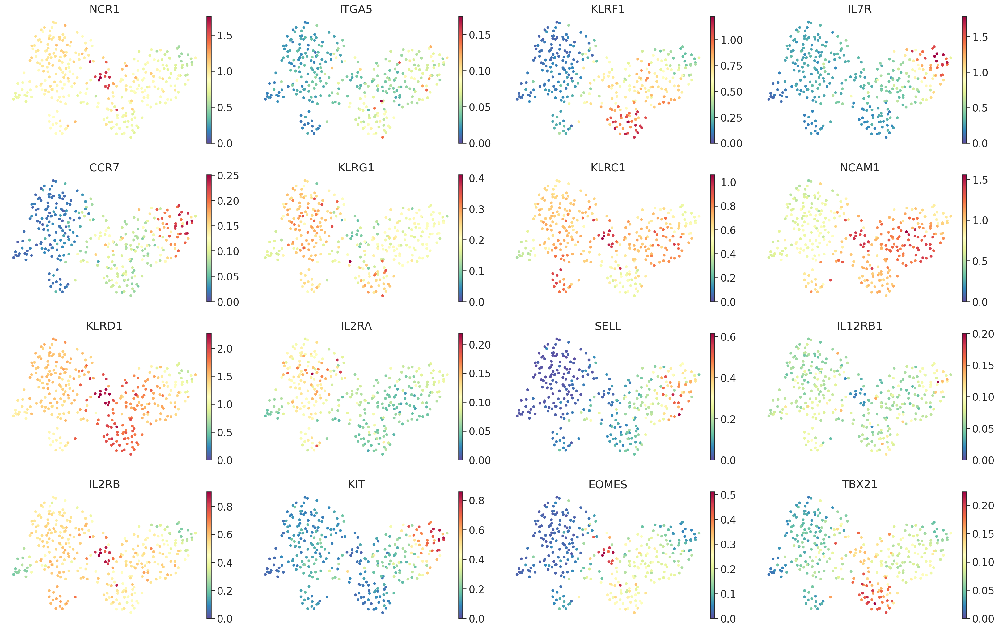

In [299]:
genes_oi = [x for x in list(G.identities['CD56bright-NK']) if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, 
           palette=color_map_clusters_nogrey, s = 80, cmap= 'Spectral_r', layer='imputed',legend_fontsize = 10, vmin=0)

In [301]:
G.identities.keys()

dict_keys(['TCM', 'TSCM', 'CD8-T_KLRG1pos-effector', 'TEM', 'FDC', 'Langerhans', 'B-memory-DN', 'Treg', 'B-memory-non-switched', 'CD56bright-NK', 'mono', 'B-pb-t1', 'NK-adaptive', 'mast', 'TRM', 'CD4-T', 'cDC2', 'p-DC', 'GC-B', 'B-memory-IgM-MZ', 'CD8-T', 'NK', 'T', 'ILC2', 'mo-DC', 'capillary', 'endo-systemic-venous', 'cDC3', 'B', 'gran', 'CD56dim-NK', 'cDC1', 'B-pb-t2', 'Lti', 'plasma', 'B-pb-mature', 'gdT', 'plasma-blast', 'CD8-T-progenitor-exhausted', 'Mac', 'B-memory-switched', 'ILC1', 'ILC3-NCRpos', 'CD8-T_KLRG1neg-effector', 'lung-endo-venous', 'ILC3-NCRneg', 'B-memory', 'endo-aerocyte', 'T-naive', 'B-naive'])

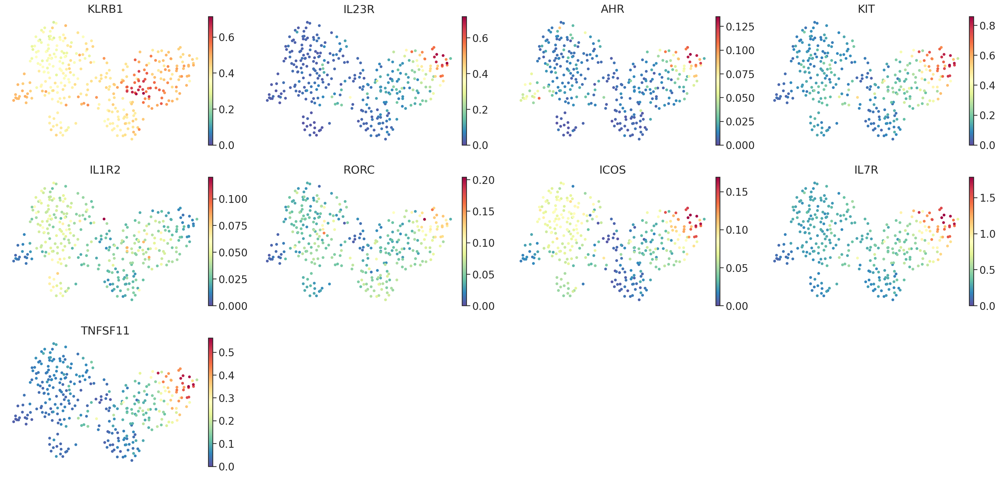

In [302]:
genes_oi = [x for x in list(G.identities['ILC3-NCRpos']) if x in adata.var_names]
sc.pl.umap(adata, color = genes_oi, 
           palette=color_map_clusters_nogrey, s = 80, cmap= 'Spectral_r', layer='imputed',legend_fontsize = 10, vmin=0)

In [303]:
pheno_heat = 'pheno_var_ILC_k40'

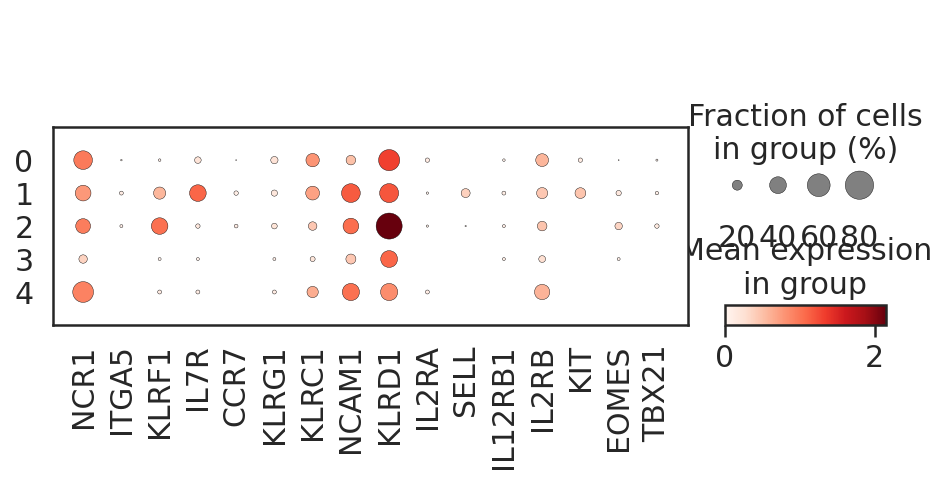

In [304]:
#dotplot
marker_genes_filtered = G.identities['CD56bright-NK']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale=None)

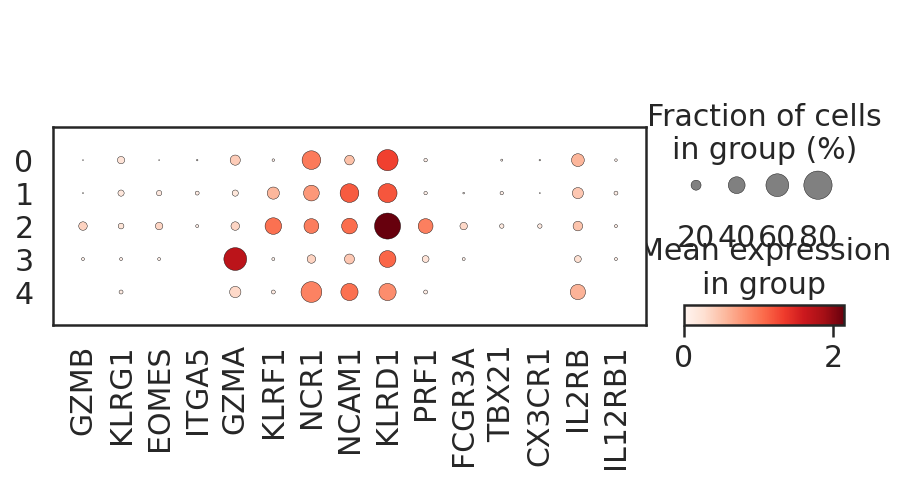

In [305]:
#dotplot
marker_genes_filtered = G.identities['CD56dim-NK']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale=None)

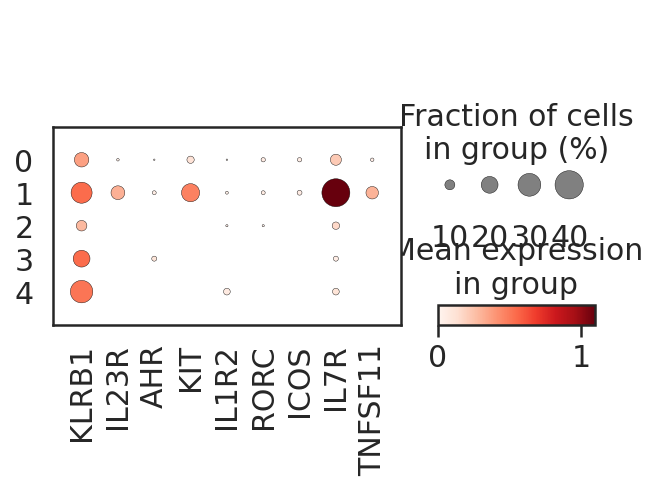

In [306]:
#dotplot
marker_genes_filtered = G.identities['ILC3-NCRpos']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale=None)

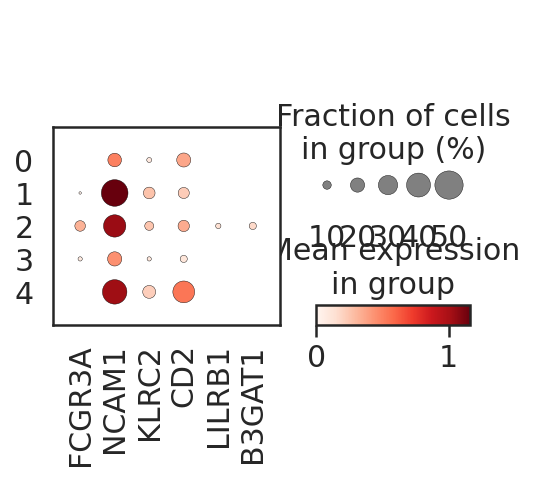

In [314]:
#dotplot
marker_genes_filtered = G.identities['NK-adaptive']
marker_genes_filtered = [x for x in marker_genes_filtered if x in adata.var_names]
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale=None)

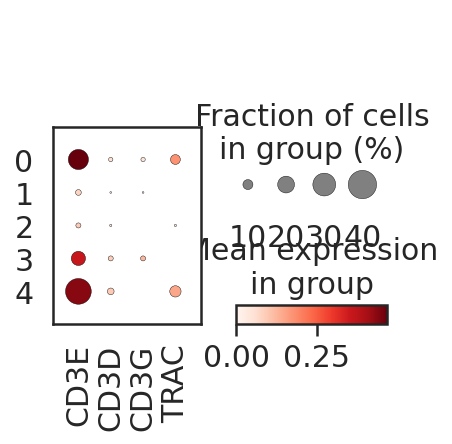

In [315]:
#dotplot
marker_genes_filtered = ['CD3E','CD3D','CD3G','TRAC']
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, standard_scale=None)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


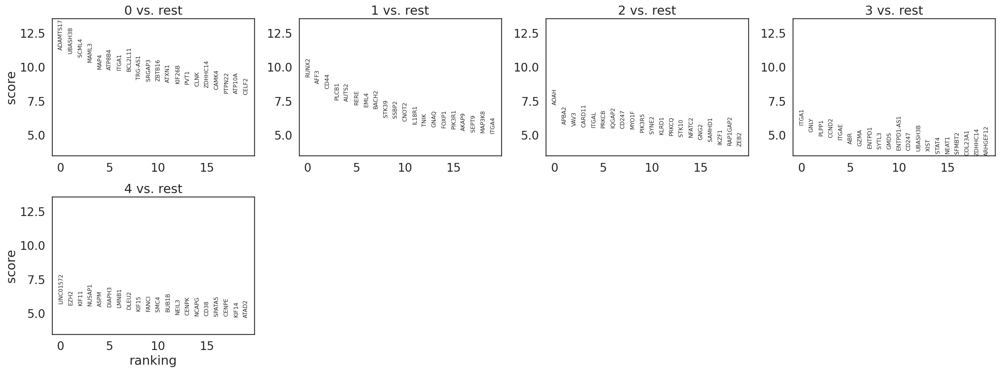

In [311]:
sc.tl.rank_genes_groups(adata, pheno_heat, method='wilcoxon')
sc.pl.rank_genes_groups(adata)

In [316]:
annotation_dict = {0:'NK',
                  1:'CD56bright-NK',
                  2:'CD56dim-NK',
                  3:'NK',
                  4:'NK'}

In [318]:
adata.obs['annotation'] = adata.obs['pheno_var_ILC_k40'].map(annotation_dict)
set(adata.obs['annotation'])

{'CD56bright-NK', 'CD56dim-NK', 'NK'}

In [321]:
adata.write(adata_save_path.format(str(number_of_hv_genes)))
print('saved data to:',adata_save_path.format(str(number_of_hv_genes)))

saved data to: /data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_2500hv_ILC_2500.h5ad


In [336]:
adata

AnnData object with n_obs × n_vars = 7714 × 13325
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF'

In [338]:
adata.obs['pheno_heat']= ['ILC_'+str(x) for x in adata.obs['pheno_var_ILC_k40']]

In [340]:
adata_save_path.format(str(number_of_hv_genes))

'/data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_2500hv_ILC_2500.h5ad'

In [341]:
adata.write(adata_save_path.format(str(number_of_hv_genes)))
print('saved data to:',adata_save_path.format(str(number_of_hv_genes)))

saved data to: /data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_2500hv_ILC_2500.h5ad


In [40]:
adata =sc.read('/data/peer/wallet/Jupyter/2023_Particle_SASP/data/TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_immune_2500hv_annotated_TNK_2500hv_ILC_2500.h5ad')
adata

AnnData object with n_obs × n_vars = 342 × 10972
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF',

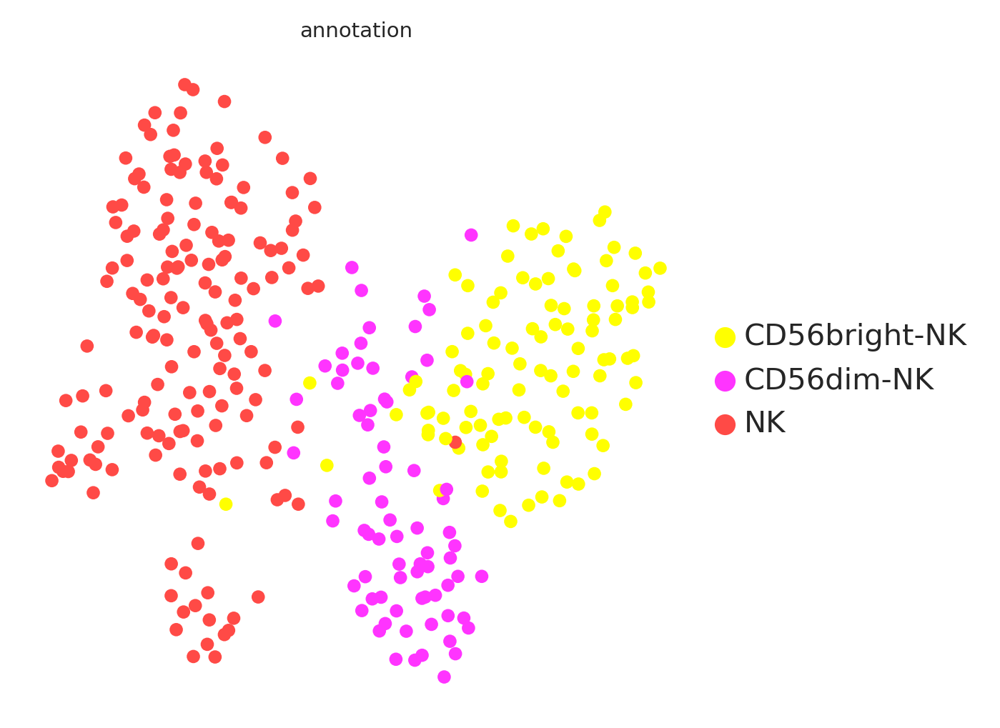

In [42]:
sc.pl.umap(adata, color = 'annotation',
           palette=color_map_clusters_nogrey, s = 80, cmap= 'Spectral_r', legend_fontsize = 10, vmin=0)